## Notebook 5
# Clusterización

## Se pide:

Se deberán probar todos los modelos posibles para cada uno de los siguientes problemas de negocio, industrializando en el paquete solamente el mejor de ellos para cada uno de los casos, con los mejores hiperparámetros y transformaciones previas encontradas.

<b>Clusterización</b>:<br>
Intentar encontrar grupos en los vídeos mediante diversas técnicas de clusterización. Evaluar cómo se superpone cada una con respecto a las categorías de los vídeos. Utilizar las técnicas de reducción de dimensionalidad.

## Importaciones

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import matplotlib.cm as cm

from matplotlib.colors import ListedColormap

from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.manifold import TSNE
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering

from plotly.subplots import make_subplots
import plotly.graph_objs as go
import plotly.offline as py
py.init_notebook_mode(connected=True)

import time

import gc

In [2]:
# funciones para graficar Classification Report y Confusion Matrix

def print_score_train(pred, y_train):
    clf_report = pd.DataFrame(classification_report(y_train, pred, output_dict=True, zero_division=np.nan))
    print("Result:\n================================================")
    print(f"Accuracy Score: {accuracy_score(y_train, pred) * 100:.2f}%")
    print("_______________________________________________")
    print(f"CLASSIFICATION REPORT:\n{clf_report}")

def graph_confusion_matrix_train(pred, y_train):
    matrix = confusion_matrix(y_train, pred)
    sns.set(font_scale=1.2)
    plt.figure(figsize=(30, 10))
    sns.heatmap(matrix, annot=True, cmap='Blues')
    plt.show()

## Carga de datos
Carga del fichero de datos generado al final del EDA.

In [3]:
df = pd.read_csv('..//data//processed//csv_eda.csv', index_col=0)

## Preparación de los datos

Vamos a partir del dataset tras el EDA, en el que hemos realizado la limpieza y escalado de los datos.<br>
A continuación aplicaremos las técnicas de reducción de dimensionalidad, y en cada una de ellas aplicaremos los algoritmos de clusterización.

<b>Conjunto de entrenamiento</b>

Seleccionamos las columnas del dataset ya codificadas y estandarizadas.

In [4]:
df.columns

Index(['title', 'channel_title', 'tags', 'views', 'likes', 'dislikes',
       'comment_count', 'comments_disabled', 'ratings_disabled', 'category',
       'country', 'trending_date_year', 'trending_date_month',
       'publish_time_year', 'publish_time_month', 'ratio_viralidad',
       'ratio_interaccion_dia', 'publish_trending_days',
       'channel_title_encoded', 'tags_encoded', 'category_encoded',
       'country_encoded', 'views_encoded', 'likes_encoded', 'dislikes_encoded',
       'comment_count_encoded', 'ratio_interaccion_dia_encoded',
       'trending_date_year_encoded', 'trending_date_month_encoded',
       'publish_time_year_encoded', 'publish_time_month_encoded'],
      dtype='object')

Seleccionamos las variables que vamos a utilizar; entre otras, no vamos a usar como variable de entrada <b>category_encoded</b>, ya que nos piden evaluar los resultados con respecto a esta variable.

In [5]:
X_train = df[['channel_title_encoded', 'tags_encoded', 'views_encoded', 'likes_encoded', 'dislikes_encoded', 'comment_count_encoded',\
              'comments_disabled', 'ratings_disabled', 'country_encoded', 'trending_date_year_encoded', 'trending_date_month_encoded', \
              'publish_time_year_encoded', 'publish_time_month_encoded', 'ratio_viralidad', 'ratio_interaccion_dia_encoded', 'publish_trending_days']]
X_train

,channel_title_encoded,tags_encoded,views_encoded,likes_encoded,dislikes_encoded,comment_count_encoded,comments_disabled,ratings_disabled,country_encoded,trending_date_year_encoded,trending_date_month_encoded,publish_time_year_encoded,publish_time_month_encoded,ratio_viralidad,ratio_interaccion_dia_encoded,publish_trending_days
0,7408,15414,2.195188,4.501606,1.803614,4.773962,False,False,0,-1.823782,0.909091,-1.758901,0.909091,0.055758,4.334115,3
1,28209,87447,-0.046118,0.536588,-0.020748,0.342217,False,False,0,-1.823782,0.909091,-1.758901,0.909091,0.140454,0.455009,0
2,20687,88781,0.256091,0.646234,0.138859,0.151795,False,False,0,-1.823782,0.909091,-1.758901,0.909091,0.049995,0.536320,1
3,29088,91178,0.103985,0.563307,-0.007590,0.518462,False,False,0,-1.823782,0.909091,-1.758901,0.909091,0.072404,0.499064,1
4,7030,64232,4.467192,9.591119,0.827083,3.171140,False,False,0,-1.823782,0.909091,-1.758901,0.909091,0.051912,8.064620,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
375937,910,51299,0.047033,-0.002199,-0.033994,-0.065135,False,False,9,0.548311,0.454545,0.568537,0.363636,0.025037,-0.007461,26
375938,30196,51138,-0.039156,0.129129,-0.077842,-0.014908,False,False,9,0.548311,0.454545,0.568537,0.363636,0.060411,0.106531,26
375939,3535,21958,-0.038926,0.057358,-0.049426,-0.012709,False,False,9,0.548311,0.454545,0.568537,0.363636,0.049784,0.048649,26
375940,10426,8106,0.598922,0.928280,0.029875,0.344494,False,False,9,0.548311,0.454545,0.568537,0.363636,0.036901,0.850929,27


Nos piden comparar los resultados con las categorías de los vídeos, por lo que guardamos esta variable.

In [6]:
y_train = df[['category_encoded']].copy(deep=True)
y_train

,category_encoded
0,8
1,1
2,1
3,3
4,8
...,...
375937,12
375938,11
375939,3
375940,4


Ya no vamos a utilizar el dataframe, sólo X_train e y_train, por lo que podemos eliminar de memoria df.

In [7]:
# elimina el dataframe
del df
# llama al recolector de basura para liberar memoria
gc.collect()

49

<b>Muestreo del dataset</b>

Por capacidad computacional, en algunos momentos voy a trabajar sólo con un muestreo de los datos, en vez de con el dataset completo.

In [8]:
porcentaje=0.1

X_train_sampled = X_train.sample(frac=porcentaje, ignore_index=True, random_state=42)
X_train_sampled.shape

(36228, 16)

In [9]:
y_train_sampled = y_train.sample(frac=porcentaje, ignore_index=True, random_state=42)
y_train_sampled.shape

(36228, 1)

# 1. PCA (Análisis de Componentes Principales)

<b>Elección de componentes</b>

Vamos a graficar la varianza explicada acumulada en relación a la varianza individual.

In [10]:
# PCA con todos los componentes
pca = PCA(n_components=None)

In [11]:
pca.fit(X_train.values)

PCA()

In [12]:
# varianza individual
var_exp = pca.explained_variance_ratio_
var_exp

array([9.42230192e-01, 5.77697793e-02, 1.88915593e-08, 5.56354725e-09,
       2.22903799e-09, 1.36339866e-09, 4.50427901e-10, 2.42810509e-10,
       5.14254405e-11, 2.62733238e-11, 1.74849987e-11, 1.60548136e-11,
       8.75854633e-12, 1.21546013e-12, 1.99025690e-13, 1.32508899e-13])

In [13]:
# varianza acumulada
cum_var_exp = np.cumsum(var_exp)
cum_var_exp

array([0.94223019, 0.99999997, 0.99999999, 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        , 1.        , 1.        , 1.        , 1.        ,
       1.        ])

In [14]:
# graficamos la varianza
def graficar_varianza(X_train, var_exp, cum_var_exp):
    '''
    Grafica la varianza
    :X_train: conjunto de entrenamiento
    :var_exp: varianza individual
    :cum_var_exp: varianza acumulada
    '''
    trace1 = go.Scatter(
        x = list(range(1, X_train.shape[0]+1)),
        y = cum_var_exp,
        mode = 'lines+markers',
        name = "'Varianza Explicada Acumulada'",
    #    hoverinfo= cum_var_exp,
        line = dict(
            shape = 'spline',
            color = 'goldenrod'
        )
    )

    trace2 = go.Scatter(
        x = list(range(1, X_train.shape[0]+1)),
        y = var_exp,
        mode = 'lines+markers',
        name = "'Varianza Explicada Individual'",
        #    hoverinfo= var_exp,
        line = dict(
            shape = 'linear',
            color = 'black'
        )
    )

    # crea la figura
    fig = go.Figure(data=[trace1, trace2])

    #opciones de diseño
    fig.update_layout(
        title = 'Varianza Explicada',
        xaxis_title = 'Componente Principal',
        yaxis_title = 'Varianza',
        showlegend = True
    )

    fig.show()

In [15]:
# graficamos la varianza
plt.figure(figsize=(20, 6))
graficar_varianza(X_train, var_exp, cum_var_exp)

<Figure size 2000x600 with 0 Axes>

La gráfica nos muestra que el primer componente principal proporciona el 94,2% de la varianza acumulada, y los dos primeros componentes prácticamente el 100%.

<b>Entrenamiento de PCA</b>

Vamos por tanto a utilizar sólo los dos primeros componentes principales para entrenar el algoritmo.

In [16]:
num_comp = 2
model_pca = PCA(num_comp)

model_pca.fit(X_train)
X_pca = model_pca.transform(X_train)

Entreno el algoritmo también con la versión muestreada del dataset.

In [17]:
model_pca_sampled = PCA(num_comp)
model_pca_sampled.fit(X_train_sampled)
X_pca_sampled = model_pca_sampled.transform(X_train_sampled)

<b>Graficamos y evaluamos</b>

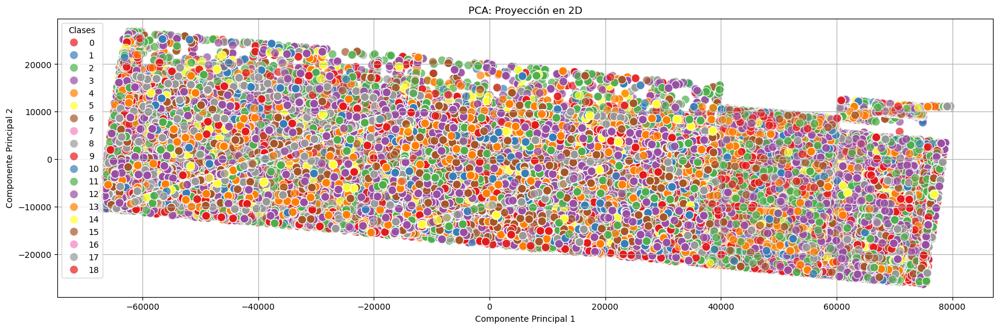

In [18]:
plt.figure(figsize=(20, 6))

sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=y_train['category_encoded'], palette='Set1', s=100, alpha=0.7)

plt.title("PCA: Proyección en 2D")
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title="Clases", loc='best')
plt.grid(True)
plt.show()

Las clases no se muestran bien separadas en el gráfico.

<b>Evaluar la categoría</b>

Aunque PCA es un método no supervisado, y por tanto no busca diferenciar clases entre los datos, vamos a evaluar su resultado en comparación con la variable category.<br>
Para ello, vamos a aplicar clusterización al resultado obtenido en el PCA.

### 1-1. K-Means

In [19]:
X_train.columns

Index(['channel_title_encoded', 'tags_encoded', 'views_encoded',
       'likes_encoded', 'dislikes_encoded', 'comment_count_encoded',
       'comments_disabled', 'ratings_disabled', 'country_encoded',
       'trending_date_year_encoded', 'trending_date_month_encoded',
       'publish_time_year_encoded', 'publish_time_month_encoded',
       'ratio_viralidad', 'ratio_interaccion_dia_encoded',
       'publish_trending_days'],
      dtype='object')

<b>Selección del número de clusters</b><br>
Gráficos de análisis de siluetas.

In [20]:
from sklearn.metrics import silhouette_samples, silhouette_score

def sel_num_clusters(X, range_n_clusters):
    '''
    Análisis de siluetas para estudiar la distancia de separación entre los grupos resultantes de aplicar K-Means.
    :X: datos de entrada, array (n_samples, n_features)
    :range_n_clusters: lista de la cantidad de cluster a comprobar
    '''
    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=10)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print(
            "For n_clusters =",
            n_clusters,
            "The average silhouette_score is :",
            silhouette_avg,
        )

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(
                np.arange(y_lower, y_upper),
                0,
                ith_cluster_silhouette_values,
                facecolor=color,
                edgecolor=color,
                alpha=0.7,
            )

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(
            X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
        )

        # Labeling the clusters
        centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        ax2.scatter(
            centers[:, 0],
            centers[:, 1],
            marker="o",
            c="white",
            alpha=1,
            s=200,
            edgecolor="k",
        )

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(
            "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
            % n_clusters,
            fontsize=14,
            fontweight="bold",
        )

    plt.show()

For n_clusters = 2 The average silhouette_score is : 0.5593604155284575
For n_clusters = 3 The average silhouette_score is : 0.4830109773746092
For n_clusters = 4 The average silhouette_score is : 0.4833827212826837
For n_clusters = 5 The average silhouette_score is : 0.4006560362524537
For n_clusters = 6 The average silhouette_score is : 0.394071011574215
For n_clusters = 7 The average silhouette_score is : 0.4220343014509059
For n_clusters = 8 The average silhouette_score is : 0.4103534749423223


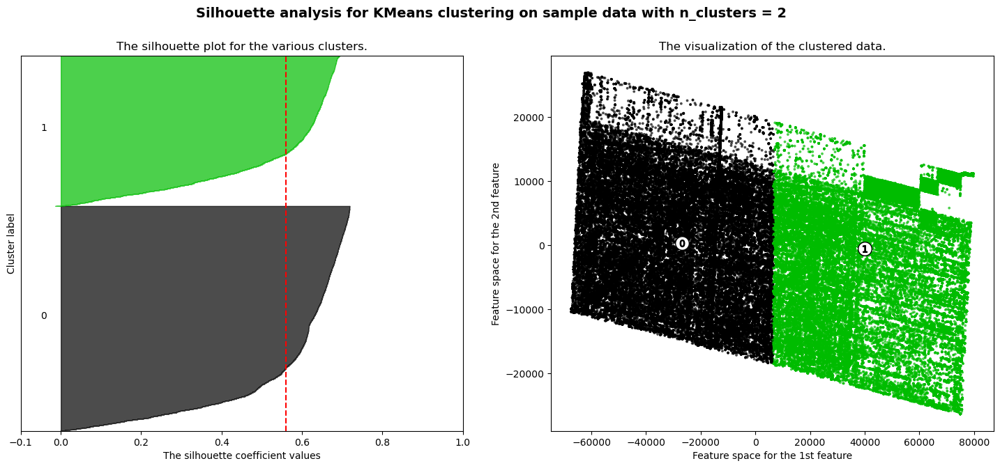

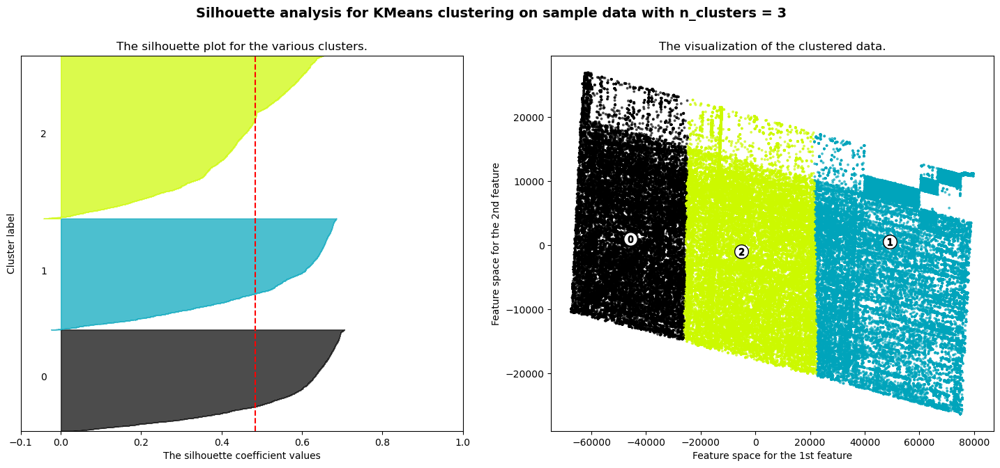

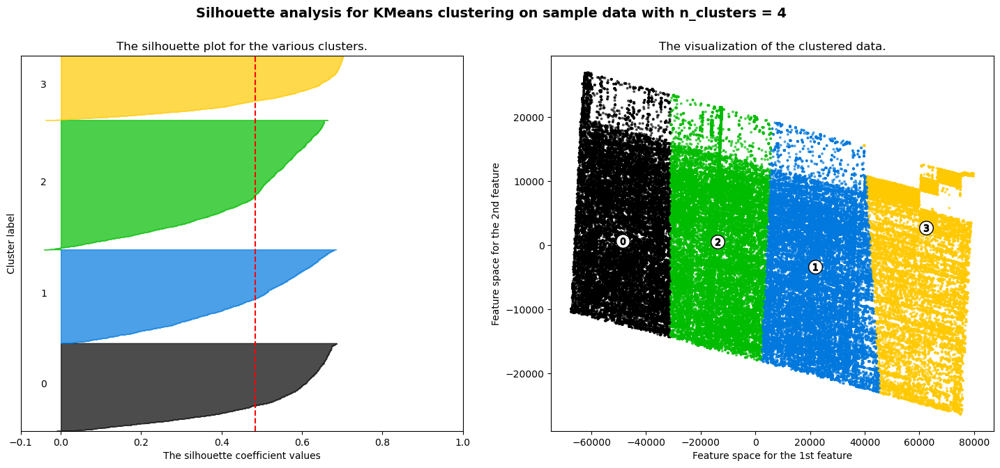

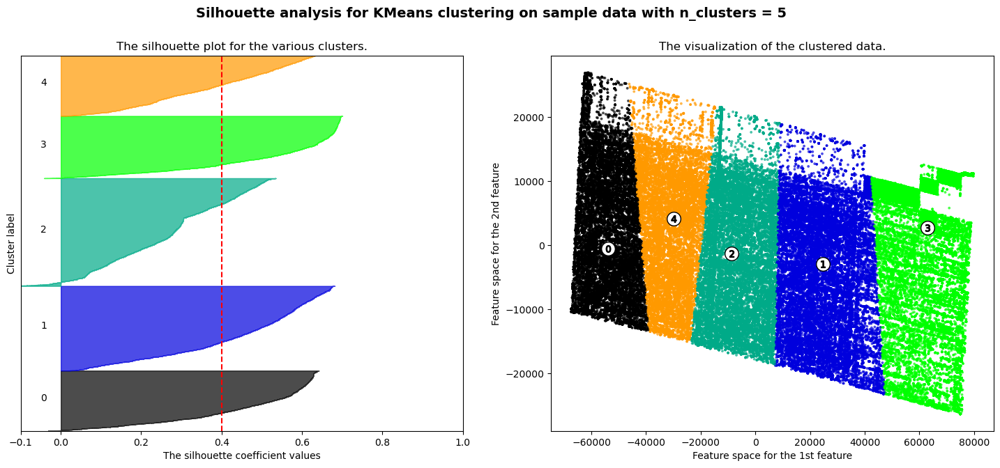

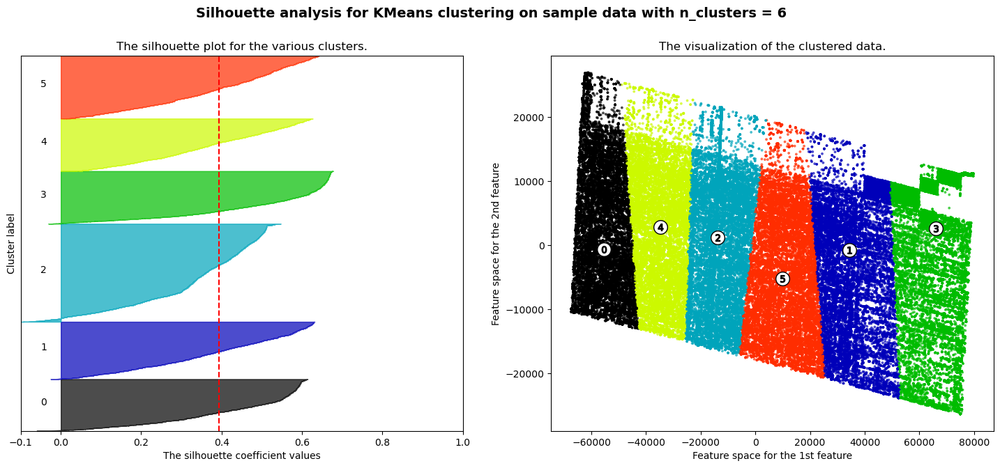

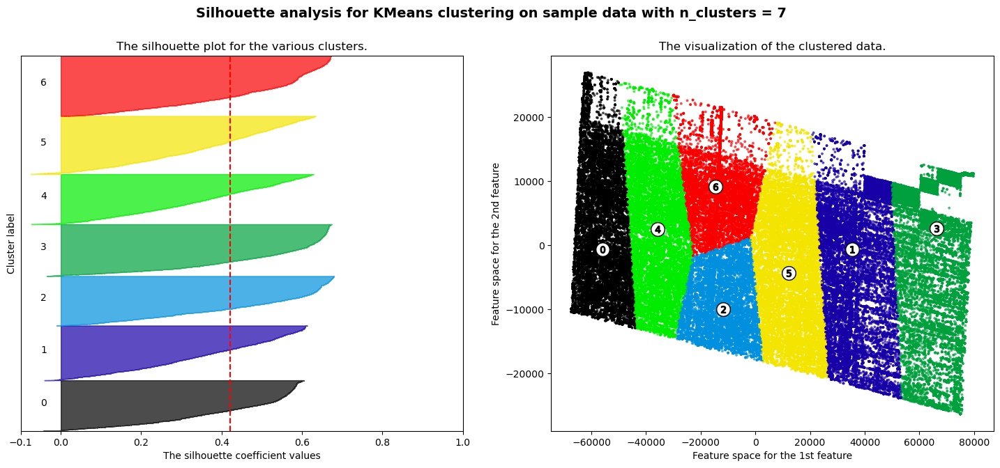

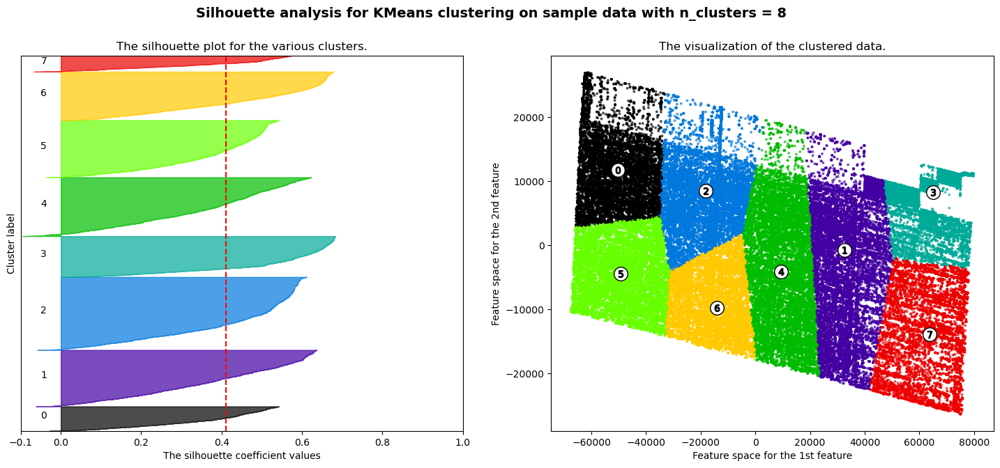

In [21]:
sel_num_clusters(X_pca, [2, 3, 4, 5, 6, 7, 8])

No hay una gran variación en el valor promedio de las muestras entre los diferentes casos estudiados, van de 39,4 a 55,9%.<br>
Por otra parte, todos los casos presentan todos sus grupos con sus puntuaciones de silueta por encima del valor promedio (línea roja del gráfico), pero sí hay fluctuaciones en el tamaño de los gráficos de silueta: muy gruesos para 2 y 3 clusters, debido a que agrupan varios clusters, y a partir de 7 clusters hay algunos muy finos.<br>
Quedarían los casos con 4, 5 y 6 clusters. El de 4 clusters presenta gráficos de silueta más uniformes, además de tener el mayor valor promedio de las muestras, 48,3 frente a 40,1% y a 39,4%.<br>
Por tanto, vamos a trabajar con 4 clusters.

For n_clusters = 19 The average silhouette_score is : 0.4167741980389899


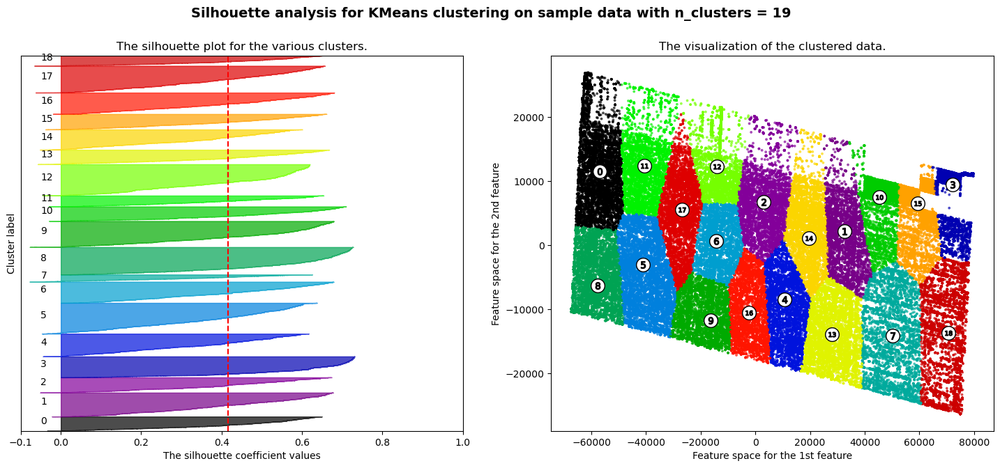

In [22]:
sel_num_clusters(X_pca, [19])

Se estudia también el caso de 19 clusters, por las 19 clases de la variable category. Los grupos están todos por encima del valor promedio, aunque algunos grupos son excesivamente finos. El valor promedio baja al 41.7%.

<b>4 clusters</b>

*PARÁMETROS*
- init='k-means++': acerca la convergencia
   - random
   - matriz
   - objeto invocable
- n_init='auto': núm veces que se ejecuta el algoritmo
    - init='k-means++' > 'auto'=1
    - init='random' > 'auto'=10
- max_iter=300: núm máx para una sola ejecución
- tol=0.0001

In [23]:
n_clusters_kmeans = 4
kmeans_4 = KMeans(n_clusters=n_clusters_kmeans, verbose=2, random_state=54)

In [24]:
kmeans_pca_4 = kmeans_4.fit(X_pca)
predicted_kmeans_pca_4 = kmeans_pca_4.predict(X_pca)

Initialization complete
Iteration 0, inertia 75300601610581.81.
Iteration 1, inertia 66821343224241.11.
Iteration 2, inertia 66563337380710.95.
Iteration 3, inertia 66432157885102.55.
Iteration 4, inertia 66369258593754.836.
Iteration 5, inertia 66343603919797.414.
Iteration 6, inertia 66324640465819.75.
Converged at iteration 6: center shift 45079.01429002663 within tolerance 79478.191925273.


Graficamos

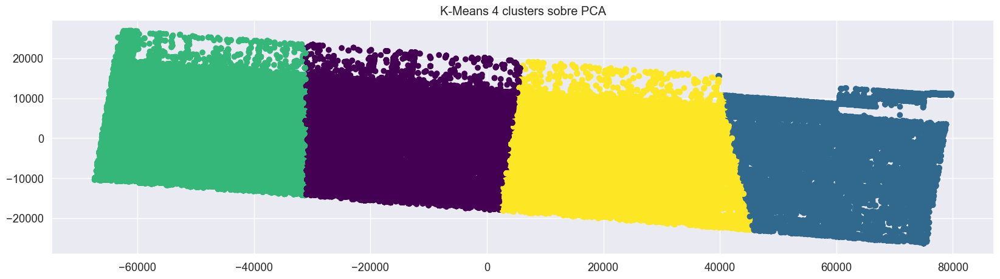

In [25]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

plt.scatter(X_pca[:, 0], X_pca[:, 1], c=predicted_kmeans_pca_4, cmap='viridis')
plt.title('K-Means 4 clusters sobre PCA')
plt.show()

K-Means con dos componentes principales proporciona una separación clara entre grupos.

### Categorías de los vídeos

Vamos a comparar la separación en 19 clusters, al tener 19 valores diferentes las categorías de los vídeos.

<b>19 clusters</b>

In [26]:
n_clusters_kmeans = 19
kmeans_19 = KMeans(n_clusters=n_clusters_kmeans, verbose=2, random_state=54)

In [27]:
kmeans_pca_19 = kmeans_19.fit(X_pca)
predicted_kmeans_pca_19 = kmeans_pca_19.predict(X_pca)

Initialization complete
Iteration 0, inertia 17380072967159.975.
Iteration 1, inertia 14133819536893.371.
Iteration 2, inertia 13734190485726.824.
Iteration 3, inertia 13497743450967.621.
Iteration 4, inertia 13287216363725.217.
Iteration 5, inertia 13186069151198.672.
Iteration 6, inertia 13133875181975.523.
Iteration 7, inertia 13087421827222.37.
Iteration 8, inertia 13048787567748.234.
Iteration 9, inertia 13026865553083.598.
Iteration 10, inertia 13014800812156.43.
Iteration 11, inertia 13004485554556.32.
Iteration 12, inertia 12996839282233.21.
Iteration 13, inertia 12990769084120.496.
Iteration 14, inertia 12982298079884.39.
Iteration 15, inertia 12963422011872.031.
Iteration 16, inertia 12906956190760.875.
Iteration 17, inertia 12800615202819.588.
Iteration 18, inertia 12731648945523.135.
Iteration 19, inertia 12700978183742.736.
Iteration 20, inertia 12686236052280.049.
Iteration 21, inertia 12679684718987.53.
Iteration 22, inertia 12676174658374.7.
Converged at iteration 22: c

Graficamos y evaluamos

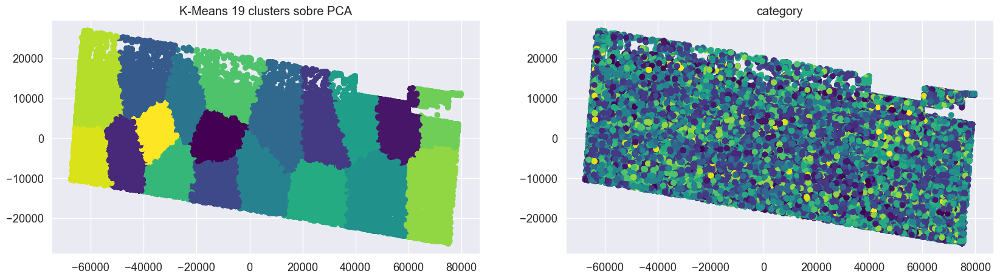

In [28]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# predicciones de K-Means con 19 clusters
plt.subplot(121)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=predicted_kmeans_pca_19, cmap='viridis')
plt.title('K-Means 19 clusters sobre PCA')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_train['category_encoded'], cmap='viridis')
plt.title('category')

plt.show()

In [29]:
print_score_train(predicted_kmeans_pca_19, y_train)

Result:
Accuracy Score: 5.94%
_______________________________________________
CLASSIFICATION REPORT:
                     0             1            2              3  \
precision     0.009626      0.076983     0.012323       0.379751   
recall        0.045181      0.049498     0.033876       0.091578   
f1-score      0.015871      0.060254     0.018072       0.147569   
support    4648.000000  25981.000000  7616.000000  104403.000000   

                      4             5             6     7             8  \
precision      0.070730      0.040550      0.065560   0.0      0.109594   
recall         0.099318      0.036863      0.089515   0.0      0.070651   
f1-score       0.082621      0.038618      0.075687   0.0      0.085916   
support    20097.000000  11041.000000  18522.000000  30.0  41245.000000   

                      9  ...           12           13          14  \
precision      0.094185  ...     0.003036     0.017513    0.006049   
recall         0.018368  ...     0.005992 

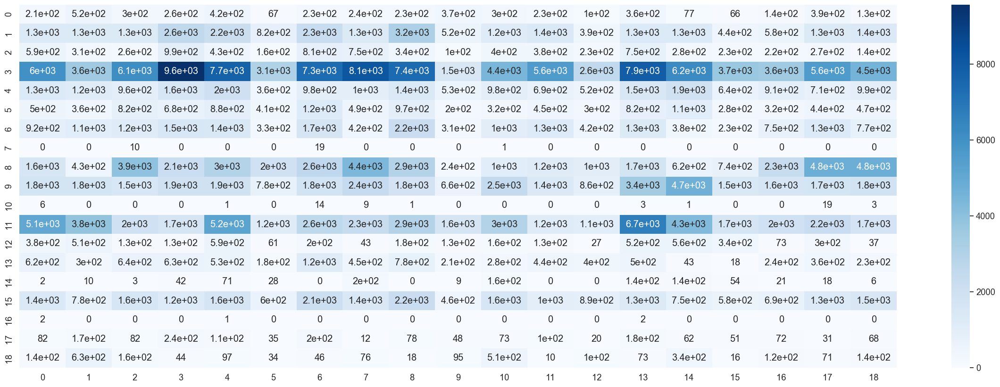

In [30]:
graph_confusion_matrix_train(predicted_kmeans_pca_19, y_train)

Comprobamos que PCA, al ser no supervisado, no contribuye a identificar las categorías de los vídeos.

In [31]:
# elimina variables
del predicted_kmeans_pca_4, predicted_kmeans_pca_19
# llama al recolector de basura para liberar memoria
gc.collect()

95522

### 1-2. Mean Shift

In [32]:
# estimación del radio de ventana
n_samples = int(X_pca.shape[0]*0.25)
print('n_samples:', n_samples)

bandwidth = estimate_bandwidth(X_pca, quantile = 0.5, n_samples = n_samples)
print('bandwidth:', bandwidth)

n_samples: 90570
bandwidth: 43628.879222456264


La estimación del radio de ventana lleva a un único cluster, por lo que hacemos pruebas con radios de valor inferior.

In [33]:
seeds_pca = None   # None: semillas para inicializar el centroide; matriz (n_samples, n_features)
bin_seeding_pca = True   # False: True: inicialización más rápida al agrupar los puntos en bins antes de calcular los clusters; bueno para grandes conjuntos de datos, especialmente con bandwidth pequeños; sin uso si seeds != None
bandwidth_pca = 9_000   # None: radio de la ventana; None: estimado; float
min_bin_freq_pca = 1   # 1: mín. puntos de cada centroide
cluster_all_pca = True   # True: False, admite huérfanos (grupo -1)
max_iter_pca = 300   # 300: máx. iteraciones por semilla

params_ms_pca = {'bandwidth': bandwidth_pca, 'bin_seeding': bin_seeding_pca, 'cluster_all': cluster_all_pca, 'min_bin_freq': min_bin_freq_pca, 'max_iter': max_iter_pca}

In [34]:
print('Iterando...')

ms_pca = MeanShift(**params_ms_pca, n_jobs=-1)

model_ms_pca = ms_pca.fit(X_pca)
predicted_ms_pca = model_ms_pca.predict(X_pca)

labels_ms_pca = model_ms_pca.labels_
centers_ms_pca = model_ms_pca.cluster_centers_

print('Número de clusters:', len(centers_ms_pca))

Iterando...
Número de clusters: 18


<b>Graficamos</b>

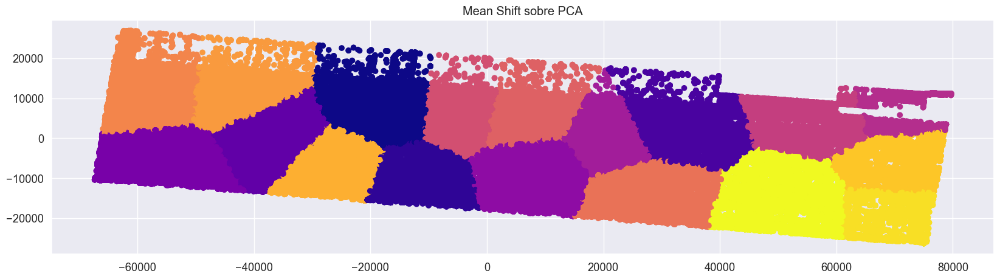

In [35]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

plt.scatter(X_pca[:, 0], X_pca[:, 1], c=predicted_ms_pca, cmap='plasma')
plt.title('Mean Shift sobre PCA')
plt.show()

Buena separación entre grupos.

### Categorías de los vídeos

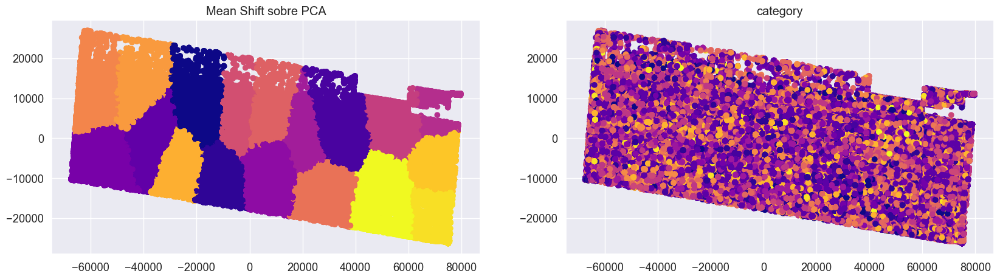

In [36]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# Mean Shift
plt.subplot(121)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=predicted_ms_pca, cmap='plasma')
plt.title('Mean Shift sobre PCA')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_train['category_encoded'], cmap='plasma')
plt.title('category')

plt.show()

In [37]:
print_score_train(predicted_ms_pca, y_train)

Result:
Accuracy Score: 5.39%
_______________________________________________
CLASSIFICATION REPORT:
                     0             1            2              3  \
precision     0.011338      0.084816     0.035837       0.269946   
recall        0.131239      0.118933     0.133272       0.075122   
f1-score      0.020872      0.099018     0.056485       0.117536   
support    4648.000000  25981.000000  7616.000000  104403.000000   

                      4             5             6     7             8  \
precision      0.041101      0.037190      0.065301   0.0      0.026591   
recall         0.068418      0.101802      0.065760   0.0      0.013626   
f1-score       0.051353      0.054478      0.065530   0.0      0.018019   
support    20097.000000  11041.000000  18522.000000  30.0  41245.000000   

                      9  ...           12           13     14            15  \
precision      0.058423  ...     0.005434     0.022821    0.0      0.061173   
recall         0.018032 

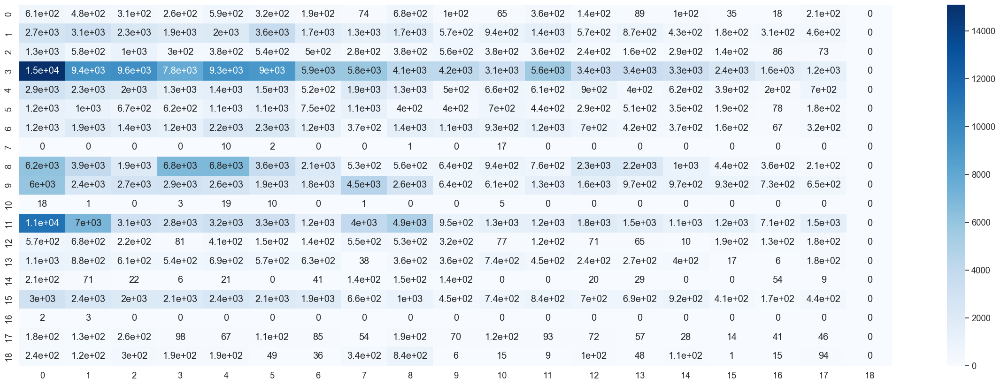

In [38]:
graph_confusion_matrix_train(predicted_ms_pca, y_train)

Mean Shift mejora sólo ligeramente la comparación entre categorías y clusters sobre lo visto para K-Means. Hay que tener en cuenta que el problema es que PCA es no supervisado.

In [39]:
# elimina variables
del predicted_ms_pca
# llama al recolector de basura para liberar memoria
gc.collect()

32521

### 1-3. DBSCAN

In [40]:
eps_pca = 900.0   # 0.5: epsilon, distancia de vecindad; > 0
min_samples_pca = 500   # 5: mínimo de puntos dentro de una vecindad
metric_pca = 'euclidean'   # euclidean; para alta dimensionalidad, mejor 'cosine' o 'manhattan'
algorithm_pca = 'auto'   # auto: 'auto', 'ball_tree', 'kd_tree', 'brute' (calcula todas las distancias); big data, más rápido usar tipo árbol
leaf_size_pca = 30   # 30: tamaño de hoja para ball_tree y kd_tree; mayor tamaño, menos hojas, entrenamiento más rápido y consultas más lentas 

params_dbscan_pca = {'eps':eps_pca, 'min_samples':min_samples_pca, 'metric':metric_pca, 'algorithm':algorithm_pca, 'leaf_size':leaf_size_pca}

In [41]:
print('Iterando...')

dbscan_pca = DBSCAN(**params_dbscan_pca, n_jobs=-1)

predicted_dbscan_pca = dbscan_pca.fit_predict(X_pca)   # DBSCAN no tiene atributo 'predict'

print('Number of clusters:', len(set(predicted_dbscan_pca)) - (1 if -1 in predicted_dbscan_pca else 0))
print('Number of outliers:', list(predicted_dbscan_pca).count(-1))

Iterando...
Number of clusters: 19
Number of outliers: 148566


<b>Graficamos</b>

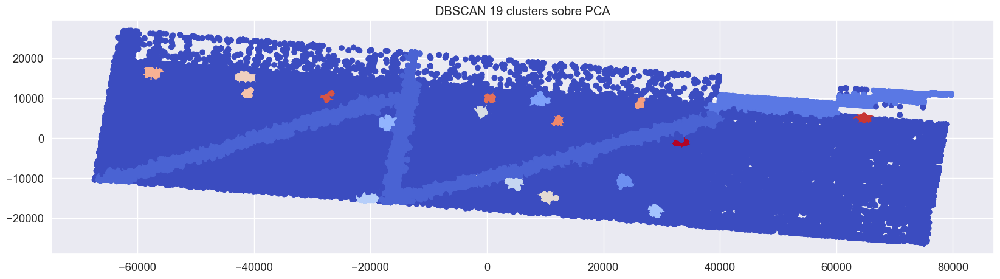

In [42]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

plt.scatter(X_pca[:, 0], X_pca[:, 1], c=predicted_dbscan_pca, cmap='coolwarm')
plt.title('DBSCAN 19 clusters sobre PCA')
plt.show()

### Categorías de los vídeos

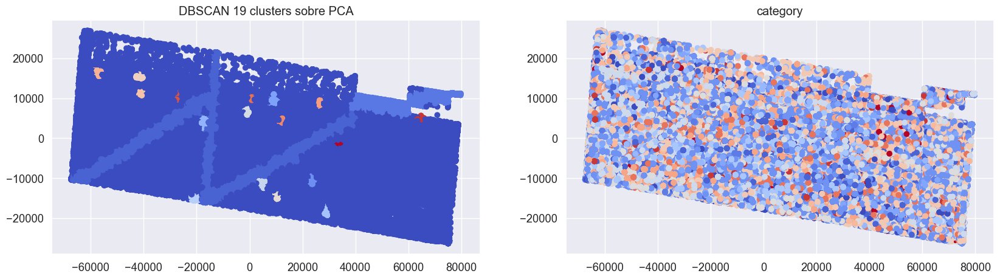

In [43]:
# Graficar resultados de DBSCAN
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# predicciones de DBSCAN
plt.subplot(121)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=predicted_dbscan_pca, cmap='coolwarm')
plt.title('DBSCAN 19 clusters sobre PCA')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_train['category_encoded'], cmap='coolwarm')
plt.title('category')

plt.show()

In [44]:
print_score_train(predicted_dbscan_pca, y_train)

Result:
Accuracy Score: 1.48%
_______________________________________________
CLASSIFICATION REPORT:
            -1            0             1       2              3  \
precision  0.0     0.011258      0.066160     0.0       0.201097   
recall     NaN     0.389845      0.102229     0.0       0.002107   
f1-score   0.0     0.021885      0.080331     0.0       0.004171   
support    0.0  4648.000000  25981.000000  7616.0  104403.000000   

                      4             5        6     7             8  ...  \
precision      0.010214      0.004225      0.0   0.0      0.023316  ...   
recall         0.000547      0.000272      0.0   0.0      0.000436  ...   
f1-score       0.001039      0.000511      0.0   0.0      0.000857  ...   
support    20097.000000  11041.000000  18522.0  30.0  41245.000000  ...   

                    12           13     14            15   16      17      18  \
precision     0.001333     0.004000    0.0      0.037523  0.0     0.0     0.0   
recall        0.0002

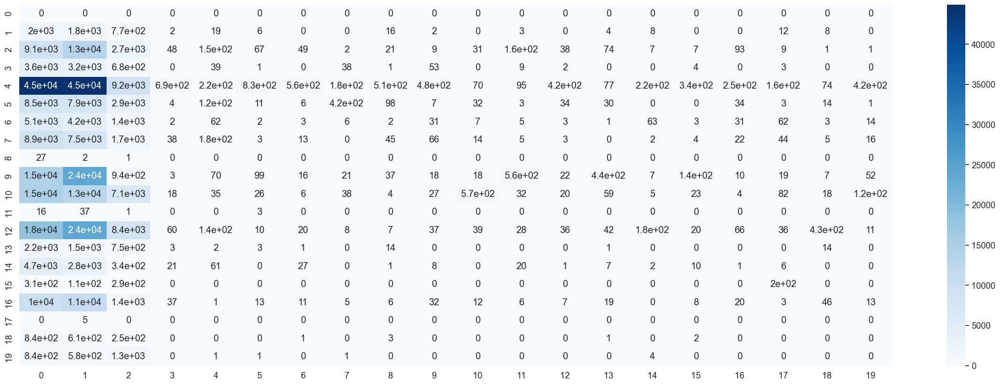

In [45]:
graph_confusion_matrix_train(predicted_dbscan_pca, y_train)

DBSCAN con PCA ofrece peor comparativa entre categorías y grupos que los métodos anteriores.

In [46]:
# elimina variables
del predicted_dbscan_pca
# llama al recolector de basura para liberar memoria
gc.collect()

34868

### 1-4. HAC

In [47]:
n_clusters_pca = None   # 2: None si distance_threshold != None
metric_pca = 'euclidean'   # euclidean: euclidean/li/l2/manhattan/cosine/precomputed; si linkage=ward, sólo euclidean
compute_full_tree_pca = 'auto'   # auto: auto/True/False; el árbol se detiene al llegar a n_clusters; útil para menor tiempo de cálculo
distance_threshold_pca = 450_000   # None: float; umbral de distancia, los clústers sólo se fusionan por debajo de este umbral; float -> n_clusters debe ser None y compute_full_tree debe ser True
linkage_pca = 'ward'   # ward: ward/complete/average/single; qué distancia usar entre conjuntos de observaciones

ac_pca = AgglomerativeClustering(n_clusters=n_clusters_pca, metric=metric_pca, compute_full_tree=compute_full_tree_pca, distance_threshold=distance_threshold_pca, linkage=linkage_pca)

In [48]:
print('Iterando...')

# por necesidades computacionales utilizo la versión muestreada
predict_ac_pca = ac_pca.fit_predict(X_pca_sampled)

labels_ac_pca = ac_pca.labels_
clusters_ac_pca = ac_pca.n_clusters_

print('Número de clusters:', clusters_ac_pca)

Iterando...
Número de clusters: 18


<b>Graficamos</b>

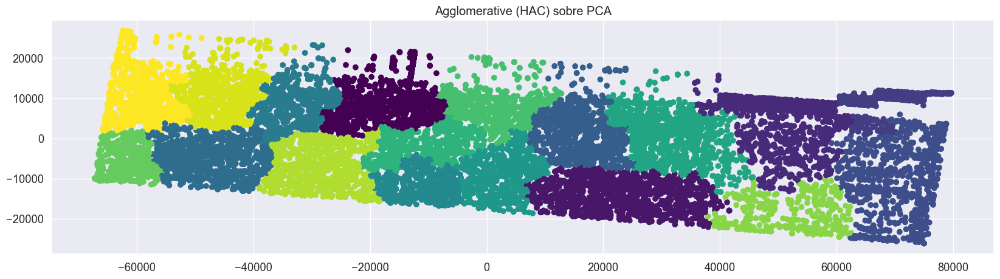

In [49]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

plt.scatter(X_pca_sampled[:, 0], X_pca_sampled[:, 1], c=predict_ac_pca, cmap='viridis')
plt.title('Agglomerative (HAC) sobre PCA')
plt.show()

HAC muestra separadas las categorías.

### Categorías de los vídeos

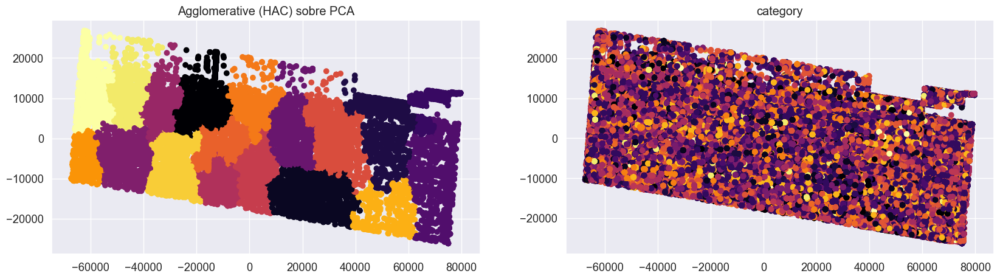

In [50]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# predicciones de HAC
plt.subplot(121)
plt.scatter(X_pca_sampled[:, 0], X_pca_sampled[:, 1], c=predict_ac_pca, cmap='inferno')
plt.title('Agglomerative (HAC) sobre PCA')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_train['category_encoded'], cmap='inferno')
plt.title('category')

plt.show()

In [51]:
print_score_train(predict_ac_pca, y_train_sampled)

Result:
Accuracy Score: 6.17%
_______________________________________________
CLASSIFICATION REPORT:
                    0            1           2             3            4  \
precision    0.009537     0.081798    0.020165      0.287203     0.051155   
recall       0.103070     0.057877    0.062341      0.066009     0.030214   
f1-score     0.017459     0.067789    0.030473      0.107346     0.037990   
support    456.000000  2609.000000  786.000000  10438.000000  2052.000000   

                     5            6    7            8            9  ...  \
precision     0.040252     0.055234  0.0     0.114947     0.040782  ...   
recall        0.088561     0.096738  0.0     0.069911     0.026556  ...   
f1-score      0.055347     0.070319  0.0     0.086943     0.032166  ...   
support    1084.000000  1778.000000  1.0  4048.000000  3615.000000  ...   

                   12          13         14           15   16          17  \
precision    0.013333    0.019117   0.004219     0.090610  

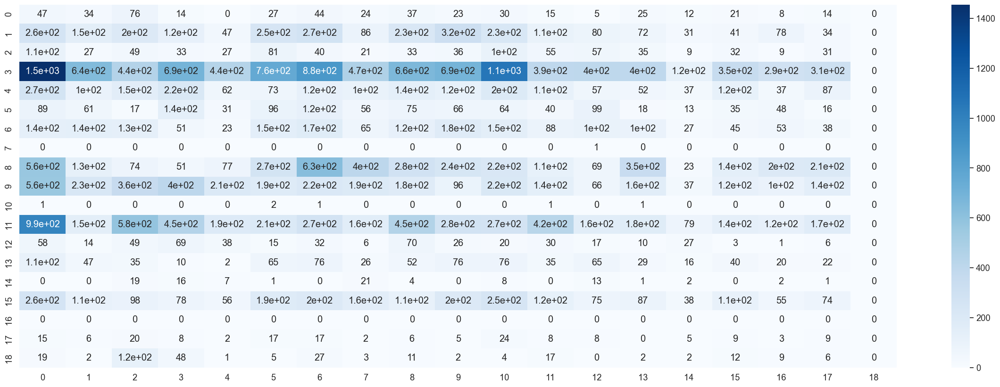

In [52]:
graph_confusion_matrix_train(predict_ac_pca, y_train_sampled)

Vemos que HAC sobre PCA tampoco identifica bien categorías y clusters.

In [53]:
# elimina variables
del predict_ac_pca, X_pca
# llama al recolector de basura para liberar memoria
gc.collect()

32530

# 2. LDA (Linear Discriminant Analysis)

In [54]:
solver_lda = 'svd'   # svd, svd (muchas características)/lsqr/eigen
shrinkage_lda = None   # None; parámetro de contracción; None/auto/float [0, 1]; sólo para lsqr y eigen; None si covariance_estimator != None
#priors_lda = None   # None; None/matriz (n_classes); probabilidades de las clases; None, inferidas del conjunto de entrenamiento
n_components_lda = None   # None; None (= min(n_classes - 1, n_features)) / int (<= min(n_classes - 1, n_features))
#store_covariance_lda = False   # False; True, calcula matriz covarianza ponderada para svd (siempre se calcula para los demás solucionadores)
tol_lda = 0.0001   # 0.0001; tolerancia para valores singulares; por debajo, la dimensión se descarta; sólo para svd.
#covariance_estimator_lda = None   # None; None, la estimación usa el parámetro shrinkage

params_lda = {'solver': solver_lda, 'shrinkage': shrinkage_lda, 'n_components': n_components_lda, 'tol': tol_lda}

In [55]:
lda = LDA(**params_lda)

model_lda = lda.fit(X_train, np.ravel(y_train))
X_lda = model_lda.transform(X_train)

Preparo también una versión de LDA con el dataset muestreado.

In [56]:
lda_sampled = LDA(**params_lda)

model_lda_sampled = lda_sampled.fit(X_train_sampled, np.ravel(y_train_sampled))
X_lda_sampled = model_lda_sampled.transform(X_train_sampled)

<b>Graficamos y evaluamos</b>

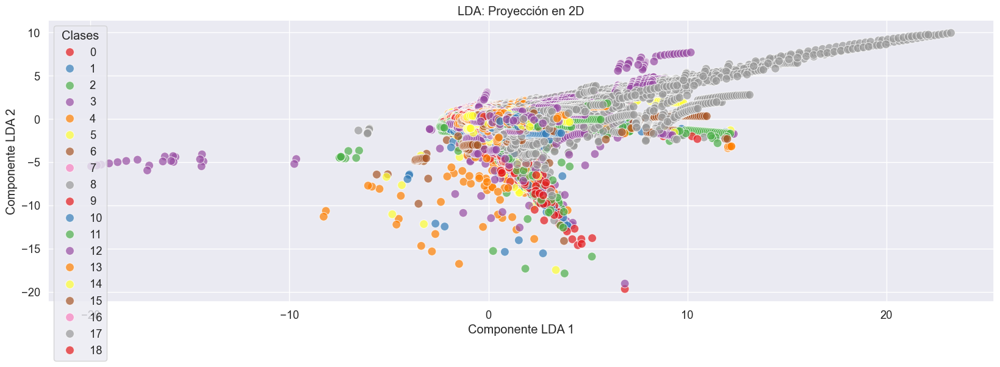

In [57]:
plt.figure(figsize=(20, 6))

sns.scatterplot(x=X_lda[:, 0], y=X_lda[:, 1], hue=y_train['category_encoded'], palette='Set1', s=100, alpha=0.7)

plt.title("LDA: Proyección en 2D")
plt.xlabel('Componente LDA 1')
plt.ylabel('Componente LDA 2')
plt.legend(title="Clases", loc='best')
plt.grid(True)
plt.show()

In [58]:
print('Accuracy:', format(model_lda.score(X_train, y_train), '.2%'))

Accuracy: 30.54%


En el gráfico vemos que las clases no están bien separadas, y el modelo presenta un accuracy de tan sólo un 30%. LDA no va a ser una buena opción para identificar la categoría.

### 2-1. K-Means

Número de clusters: el análisis de siluetas del dataset ya se ha realizado en el apartado anterior de PCA, vamos a trabajar por tanto también con 4 y con 19 clusters.

- 4 clusters

In [59]:
n_clusters_kmeans = 4
kmeans_4 = KMeans(n_clusters=n_clusters_kmeans, verbose=2, random_state=45)

In [60]:
kmeans_lda_4 = kmeans_4.fit(X_lda)
predicted_kmeans_lda_4 = kmeans_lda_4.predict(X_lda)

Initialization complete
Iteration 0, inertia 5931532.032296583.
Iteration 1, inertia 5206600.246574525.
Iteration 2, inertia 5140774.868853126.
Iteration 3, inertia 5113534.995814666.
Iteration 4, inertia 5102789.600655863.
Iteration 5, inertia 5094320.08820484.
Iteration 6, inertia 5090297.542534996.
Iteration 7, inertia 5088748.397215911.
Iteration 8, inertia 5087798.587205901.
Iteration 9, inertia 5086917.804539064.
Iteration 10, inertia 5086307.753115987.
Iteration 11, inertia 5086051.72043824.
Iteration 12, inertia 5085909.708442337.
Iteration 13, inertia 5085814.729731459.
Iteration 14, inertia 5085754.314680154.
Iteration 15, inertia 5085716.175342939.
Converged at iteration 15: center shift 9.203002510057637e-05 within tolerance 0.00010191224545688669.


Graficamos

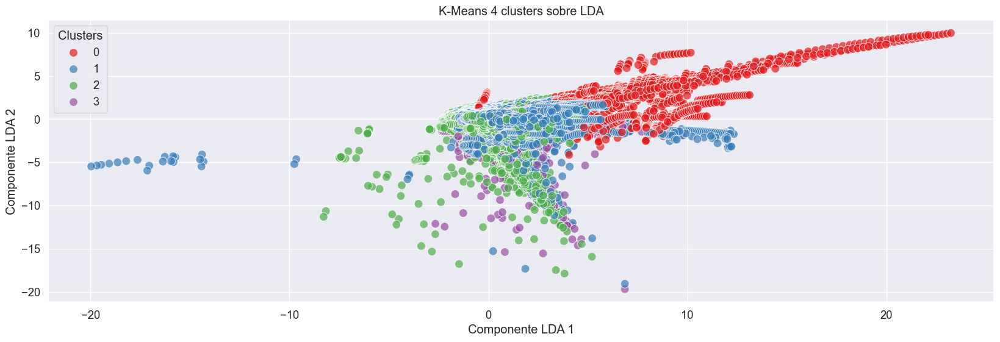

In [61]:
plt.figure(figsize=(20, 6))

sns.scatterplot(x=X_lda[:, 0], y=X_lda[:, 1], hue=predicted_kmeans_lda_4, palette='Set1', s=100, alpha=0.7)

plt.title("K-Means 4 clusters sobre LDA")
plt.xlabel('Componente LDA 1')
plt.ylabel('Componente LDA 2')
plt.legend(title="Clusters", loc='best')
plt.grid(True)
plt.show()

- 19 clusters

In [62]:
n_clusters_kmeans = 19
kmeans_19 = KMeans(n_clusters=n_clusters_kmeans, verbose=2, random_state=45)

In [63]:
kmeans_lda_19 = kmeans_19.fit(X_lda)
predicted_kmeans_lda_19 = kmeans_lda_19.predict(X_lda)

Initialization complete
Iteration 0, inertia 3417285.5243888493.
Iteration 1, inertia 2538362.855536435.
Iteration 2, inertia 2413506.911351673.
Iteration 3, inertia 2371170.2636348708.
Iteration 4, inertia 2354803.835282435.
Iteration 5, inertia 2348147.7770841965.
Iteration 6, inertia 2344412.143922358.
Iteration 7, inertia 2342387.8446714925.
Iteration 8, inertia 2341030.4472854207.
Iteration 9, inertia 2339855.0738207754.
Iteration 10, inertia 2338934.0421292307.
Iteration 11, inertia 2338209.7821015753.
Iteration 12, inertia 2337628.4182157237.
Iteration 13, inertia 2336963.7493848703.
Iteration 14, inertia 2336383.693159739.
Iteration 15, inertia 2335995.021627767.
Iteration 16, inertia 2335623.196421793.
Iteration 17, inertia 2335254.8743250705.
Iteration 18, inertia 2334882.5869473773.
Iteration 19, inertia 2334662.43006932.
Iteration 20, inertia 2334509.071116835.
Iteration 21, inertia 2334376.383226817.
Iteration 22, inertia 2334206.428361714.
Iteration 23, inertia 2334067.01

Graficamos

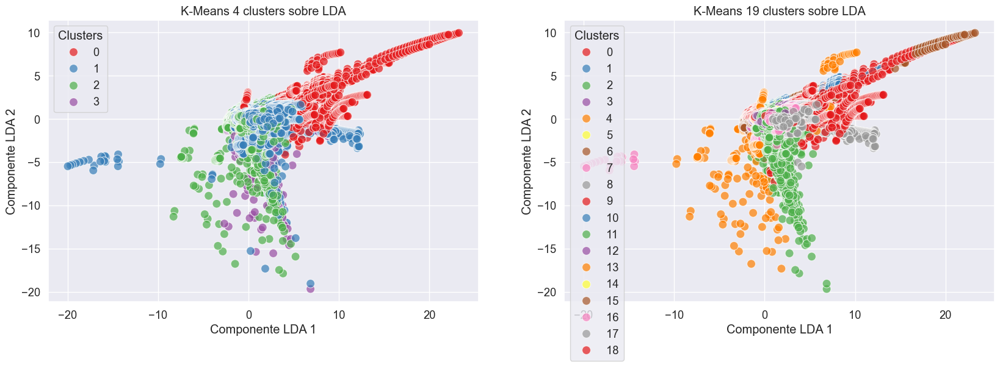

In [64]:
plt.figure(figsize=(20, 6))

# predicciones de K-Means con 4 clusters
plt.subplot(121)
sns.scatterplot(x=X_lda[:, 0], y=X_lda[:, 1], hue=predicted_kmeans_lda_4, palette='Set1', s=100, alpha=0.7)
plt.title("K-Means 4 clusters sobre LDA")
plt.xlabel('Componente LDA 1')
plt.ylabel('Componente LDA 2')
plt.legend(title="Clusters", loc='best')
plt.grid(True)

# predicciones de K-Means con 19 clusters
plt.subplot(122)
sns.scatterplot(x=X_lda[:, 0], y=X_lda[:, 1], hue=predicted_kmeans_lda_19, palette='Set1', s=100, alpha=0.7)
plt.title("K-Means 19 clusters sobre LDA")
plt.xlabel('Componente LDA 1')
plt.ylabel('Componente LDA 2')
plt.legend(title="Clusters", loc='best')
plt.grid(True)

plt.show()

### Categorías de los vídeos

Graficamos y evaluamos

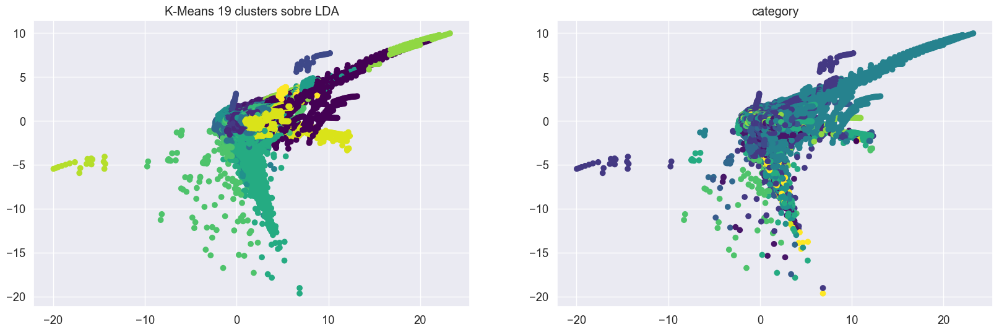

In [65]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 6))

# predicciones de K-Means con 19 clusters
plt.subplot(121)
plt.scatter(X_lda[:, 0], X_lda[:, 1], c=predicted_kmeans_lda_19, cmap='viridis')
plt.title('K-Means 19 clusters sobre LDA')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_lda[:, 0], X_lda[:, 1], c=y_train['category_encoded'], cmap='viridis')
plt.title('category')

plt.show()

In [66]:
print_score_train(predicted_kmeans_lda_19, y_train)

Result:
Accuracy Score: 7.36%
_______________________________________________
CLASSIFICATION REPORT:
                0             1            2              3        4  \
precision     0.0      0.074898     0.016719       0.281433      0.0   
recall        0.0      0.180286     0.126182       0.119460      0.0   
f1-score      0.0      0.105830     0.029526       0.167726      0.0   
support    4648.0  25981.000000  7616.000000  104403.000000  20097.0   

                      5             6          7             8             9  \
precision      0.030001      0.020917   0.000651      0.164749      0.252489   
recall         0.095281      0.007559   0.500000      0.018402      0.039759   
f1-score       0.045633      0.011105   0.001300      0.033107      0.068700   
support    11041.000000  18522.000000  30.000000  41245.000000  35715.000000   

           ...           12           13          14       15   16  \
precision  ...     0.014728     0.140389    0.003357      0.0  0.0 

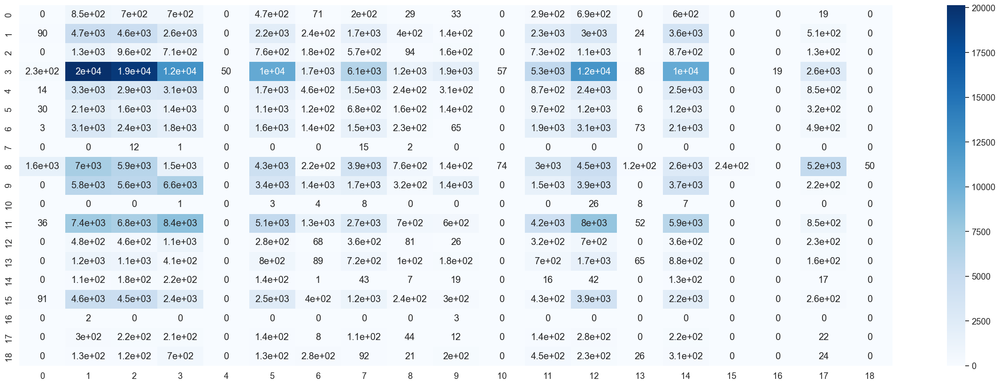

In [67]:
graph_confusion_matrix_train(predicted_kmeans_lda_19, y_train)

Los grupos obtenidos por K-Means a partir de LDA siguen dando un resultado insuficiente.

In [68]:
# elimina variables
del predicted_kmeans_lda_4, predicted_kmeans_lda_19
# llama al recolector de basura para liberar memoria
gc.collect()

43938

### 2-2. Mean Shift

In [69]:
# estimación del radio de ventana
n_samples = int(X_lda.shape[0]*0.25)
print('n_samples:', n_samples)

bandwidth = estimate_bandwidth(X_lda, quantile = 0.5, n_samples = n_samples)
print('bandwidth:', bandwidth)

n_samples: 90570
bandwidth: 4.346700861177452


El radio de ventana estimado conduce a un único cluster, hacemos pruebas con valores inferiores.

In [70]:
seeds_lda = None   # None: semillas para inicializar el centroide; matriz (n_samples, n_features)
bin_seeding_lda = True   # False: True: inicialización más rápida al agrupar los puntos en bins antes de calcular los clusters; bueno para grandes conjuntos de datos, especialmente con bandwidth pequeños; sin uso si seeds != None
bandwidth_lda = None   # None: radio de la ventana; None: estimado; float
min_bin_freq_lda = 9   # 1: mín. puntos de cada centroide
cluster_all_lda = False   # True: False, admite huérfanos (grupo -1)
max_iter_lda = 300   # 300: máx. iteraciones por semilla

params_ms_lda = {'bandwidth': bandwidth_lda, 'bin_seeding': bin_seeding_lda, 'cluster_all': cluster_all_lda, 'min_bin_freq': min_bin_freq_lda, 'max_iter': max_iter_lda}

In [71]:
ms_lda = MeanShift(**params_ms_lda, n_jobs=-1)

print('Iterando...')

model_ms_lda = ms_lda.fit(X_lda)
predicted_ms_lda = model_ms_lda.predict(X_lda)

labels_ms_lda = model_ms_lda.labels_
centers_ms_lda = model_ms_lda.cluster_centers_

print('Número de clusters:', len(centers_ms_lda))

Iterando...
Número de clusters: 20


Graficamos

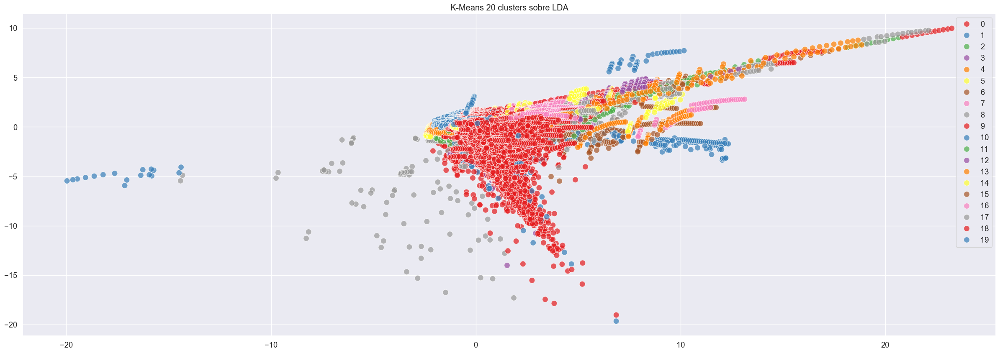

In [72]:
sns.set(font_scale=1.2)
plt.figure(figsize=(30, 10))

sns.scatterplot(x=X_lda[:, 0], y=X_lda[:, 1], hue=predicted_ms_lda, palette='Set1', s=100, alpha=0.7)
plt.title('K-Means 20 clusters sobre LDA')

plt.show()

### Categorías de los vídeos

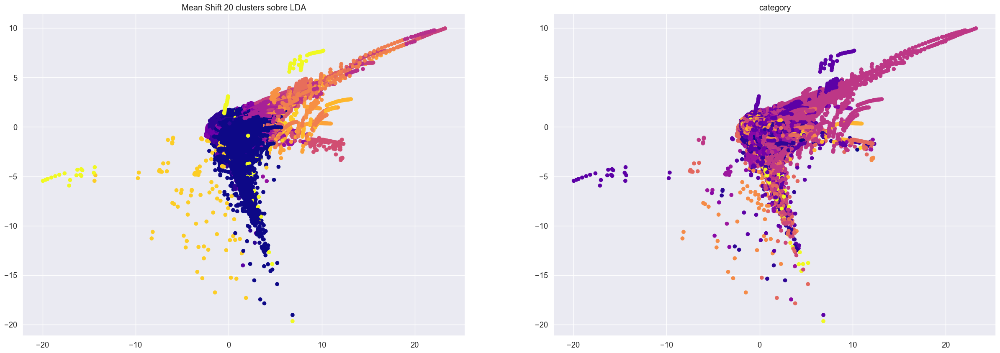

In [73]:
sns.set(font_scale=1.2)
plt.figure(figsize=(30, 10))

# Mean Shift
plt.subplot(121)
plt.scatter(X_lda[:, 0], X_lda[:, 1], c=predicted_ms_lda, cmap='plasma')
plt.title('Mean Shift 20 clusters sobre LDA')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_lda[:, 0], X_lda[:, 1], c=y_train['category_encoded'], cmap='plasma')
plt.title('category')

plt.show()

In [74]:
print_score_train(predicted_ms_lda, y_train)

Result:
Accuracy Score: 1.74%
_______________________________________________
CLASSIFICATION REPORT:
                     0             1            2              3  \
precision     0.013214      0.024707     0.005945       0.255386   
recall        0.968804      0.005350     0.003545       0.010900   
f1-score      0.026072      0.008796     0.004442       0.020908   
support    4648.000000  25981.000000  7616.000000  104403.000000   

                      4        5             6     7             8        9  \
precision      0.081690      0.0      0.013072   0.0      0.914966      0.0   
recall         0.008658      0.0      0.000108   0.0      0.006522      0.0   
f1-score       0.015657      0.0      0.000214   0.0      0.012952      0.0   
support    20097.000000  11041.0  18522.000000  30.0  41245.000000  35715.0   

           ...      13     14            15   16      17      18   19  \
precision  ...     0.0    0.0      0.140288  0.0     0.0     0.0  0.0   
recall     ...  

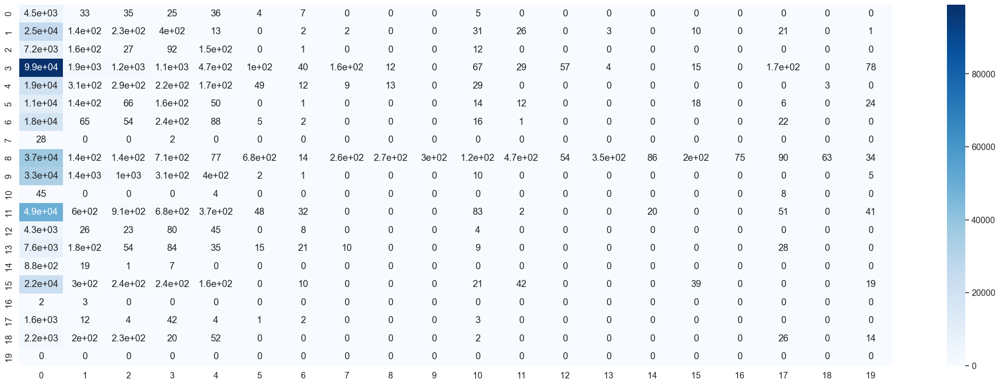

In [75]:
graph_confusion_matrix_train(predicted_ms_lda, y_train)

Mean Shift sobre LDA no muestra una correspondencia clara entre grupos y categorías.

In [76]:
# elimina variables
del predicted_ms_lda
# llama al recolector de basura para liberar memoria
gc.collect()

43954

### 2-3. DBSCAN

In [77]:
eps_lda = 5.0   # 0.5: epsilon, distancia de vecindad; > 0
min_samples_lda = 5   # 5: mínimo de puntos dentro de una vecindad
metric_lda = 'euclidean'   # euclidean; para alta dimensionalidad, mejor 'cosine' o 'manhattan'
algorithm_lda = 'auto'   # auto: 'auto', 'ball_tree', 'kd_tree', 'brute' (calcula todas las distancias); big data, más rápido usar tipo árbol
leaf_size_lda = 30   # 30: tamaño de hoja para ball_tree y kd_tree; mayor tamaño, menos hojas, entrenamiento más rápido y consultas más lentas 

params_dbscan_lda = {'eps':eps_lda, 'min_samples':min_samples_lda, 'metric':metric_lda, 'algorithm':algorithm_lda, 'leaf_size':leaf_size_lda}

In [78]:
dbscan_lda = DBSCAN(**params_dbscan_lda, n_jobs=-1)

print('Iterando...')

predicted_dbscan_lda = dbscan_lda.fit_predict(X_lda_sampled)   # DBSCAN no tiene atributo 'predict'

print('Number of clusters:', len(set(predicted_dbscan_lda)) - (1 if -1 in predicted_dbscan_lda else 0))
print('Number of outliers:', list(predicted_dbscan_lda).count(-1))

Iterando...
Number of clusters: 15
Number of outliers: 109


Graficamos

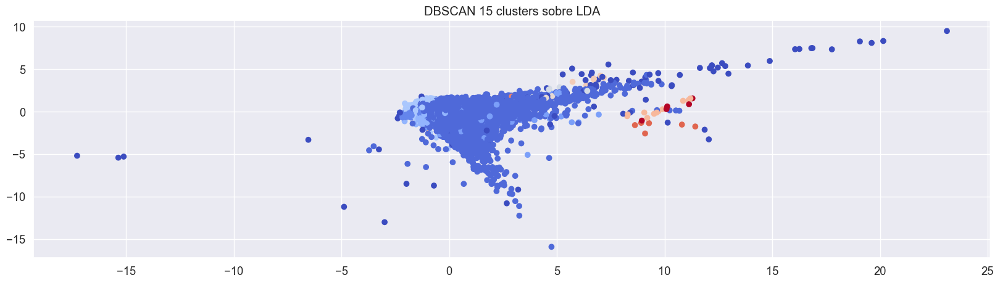

In [79]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

plt.scatter(X_lda_sampled[:, 0], X_lda_sampled[:, 1], c=predicted_dbscan_lda, cmap='coolwarm')
plt.title('DBSCAN 15 clusters sobre LDA')
plt.show()

### Categorías de los vídeos

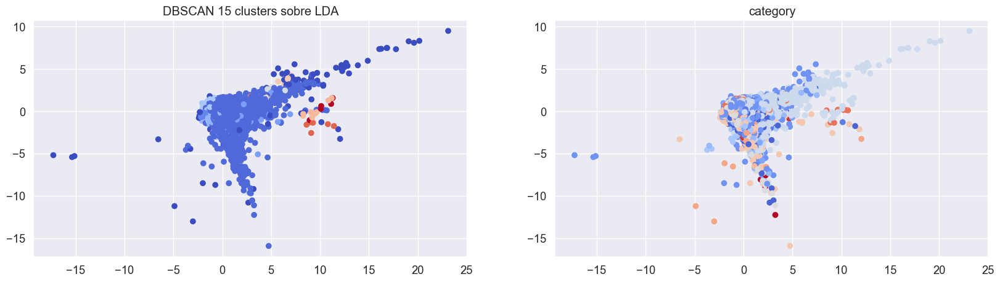

In [80]:
# Graficar resultados de DBSCAN
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# predicciones de DBSCAN
plt.subplot(121)
plt.scatter(X_lda_sampled[:, 0], X_lda_sampled[:, 1], c=predicted_dbscan_lda, cmap='coolwarm')
plt.title('DBSCAN 15 clusters sobre LDA')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_lda_sampled[:, 0], X_lda_sampled[:, 1], c=y_train_sampled['category_encoded'], cmap='coolwarm')
plt.title('category')

plt.show()

In [81]:
print_score_train(predicted_dbscan_lda, y_train_sampled)

Result:
Accuracy Score: 1.63%
_______________________________________________
CLASSIFICATION REPORT:
            -1           0            1           2             3  \
precision  0.0    0.012897     0.009302    0.025586      0.248848   
recall     NaN    0.971491     0.000767    0.015267      0.010347   
f1-score   0.0    0.025456     0.001416    0.019124      0.019868   
support    0.0  456.000000  2609.000000  786.000000  10438.000000   

                     4       5       6    7       8  ...      11     12  \
precision     0.046154     0.0     0.0  0.0     0.0  ...     0.0    0.0   
recall        0.013158     0.0     0.0  0.0     0.0  ...     0.0    0.0   
f1-score      0.020478     0.0     0.0  0.0     0.0  ...     0.0    0.0   
support    2052.000000  1084.0  1778.0  1.0  4048.0  ...  5256.0  491.0   

              13    14      15     17     18  accuracy     macro avg  \
precision    0.0   0.0     NaN    NaN    NaN  0.016341      0.021424   
recall       0.0   0.0     0.0   

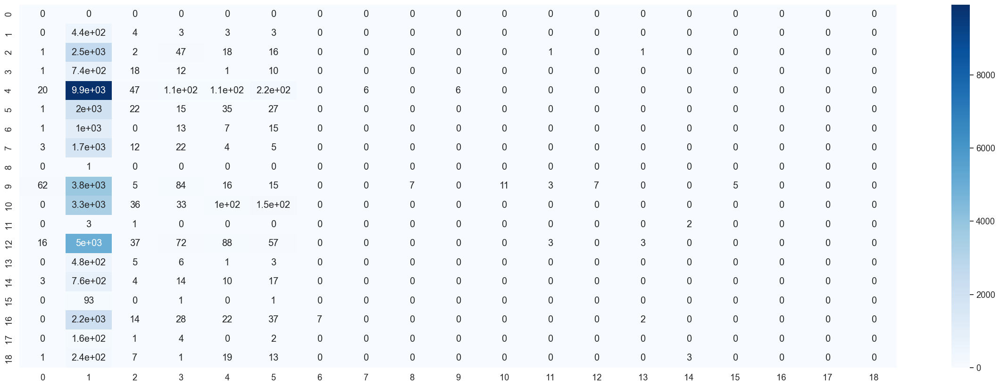

In [82]:
graph_confusion_matrix_train(predicted_dbscan_lda, y_train_sampled)

DBSCAN sobre LDA no separa bien las categorías.

In [83]:
# elimina variables
del predicted_dbscan_lda
# llama al recolector de basura para liberar memoria
gc.collect()

38759

### 2-4. HAC

In [84]:
n_clusters_lda = 19   # 2: None si distance_threshold != None
metric_lda = 'euclidean'   # euclidean: euclidean/li/l2/manhattan/cosine/precomputed; si linkage=ward, sólo euclidean
compute_full_tree_lda = 'auto'   # auto: auto/True/False; el árbol se detiene al llegar a n_clusters; útil para menor tiempo de cálculo
distance_threshold_lda = None   # None: float; umbral de distancia, los clústers sólo se fusionan por debajo de este umbral; float -> n_clusters debe ser None y compute_full_tree debe ser True
linkage_lda = 'ward'   # ward: ward/complete/average/single; qué distancia usar entre conjuntos de observaciones

ac_lda = AgglomerativeClustering(n_clusters=n_clusters_lda, metric=metric_lda, compute_full_tree=compute_full_tree_lda, distance_threshold=distance_threshold_lda, linkage=linkage_lda)

In [85]:
print('Iterando...')

# por necesidades computacionales utilizo la versión muestreada
predict_ac_lda = ac_lda.fit_predict(X_lda_sampled)

labels_ac_lda = ac_lda.labels_
clusters_ac_lda = ac_lda.n_clusters_

print('Número de clusters:', clusters_ac_lda)

Iterando...
Número de clusters: 19


Graficamos

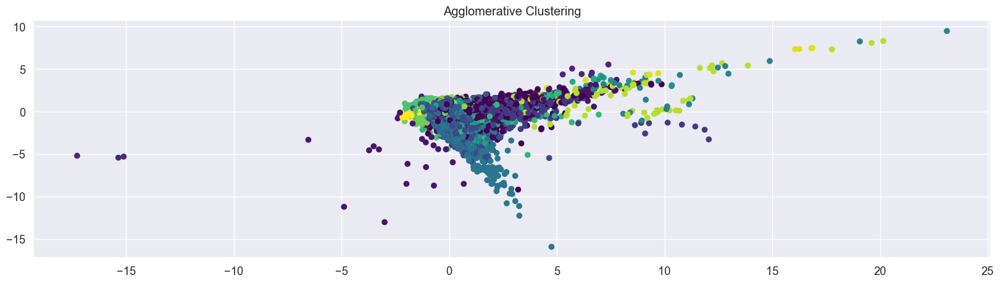

In [86]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

plt.scatter(X_lda_sampled[:, 0], X_lda_sampled[:, 1], c=predict_ac_lda, cmap='viridis')
plt.title('Agglomerative Clustering')
plt.show()

### Categorías de los vídeos

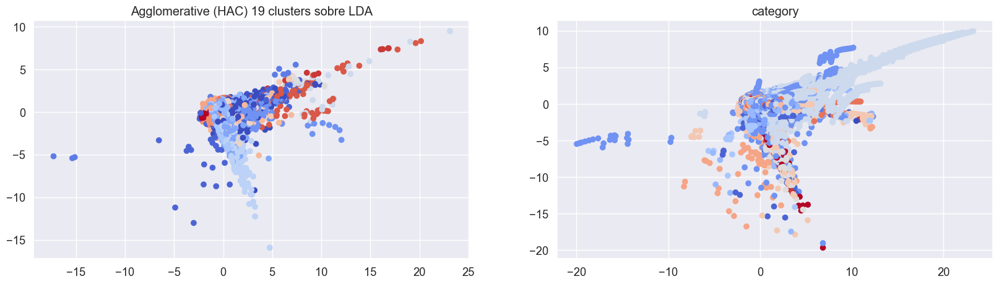

In [87]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# predicciones de HAC
plt.subplot(121)
plt.scatter(X_lda_sampled[:, 0], X_lda_sampled[:, 1], c=predict_ac_lda, cmap='coolwarm')
plt.title('Agglomerative (HAC) 19 clusters sobre LDA')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_lda[:, 0], X_lda[:, 1], c=y_train['category_encoded'], cmap='coolwarm')
plt.title('category')

plt.show()

In [88]:
print_score_train(predict_ac_lda, y_train_sampled)

Result:
Accuracy Score: 3.54%
_______________________________________________
CLASSIFICATION REPORT:
                    0            1      2             3            4  \
precision    0.007635     0.037838    0.0      0.194842     0.053095   
recall       0.120614     0.002683    0.0      0.013029     0.196881   
f1-score     0.014360     0.005011    0.0      0.024425     0.083635   
support    456.000000  2609.000000  786.0  10438.000000  2052.000000   

                     5            6    7            8       9  ...  \
precision     0.030333     0.042063  0.0     0.928571     0.0  ...   
recall        0.199262     0.111924  0.0     0.006423     0.0  ...   
f1-score      0.052651     0.061146  0.0     0.012758     0.0  ...   
support    1084.000000  1778.000000  1.0  4048.000000  3615.0  ...   

                   12          13    14           15   16     17          18  \
precision    0.012605    0.029010   0.0     0.083936  0.0    0.0    0.032864   
recall       0.012220    0.

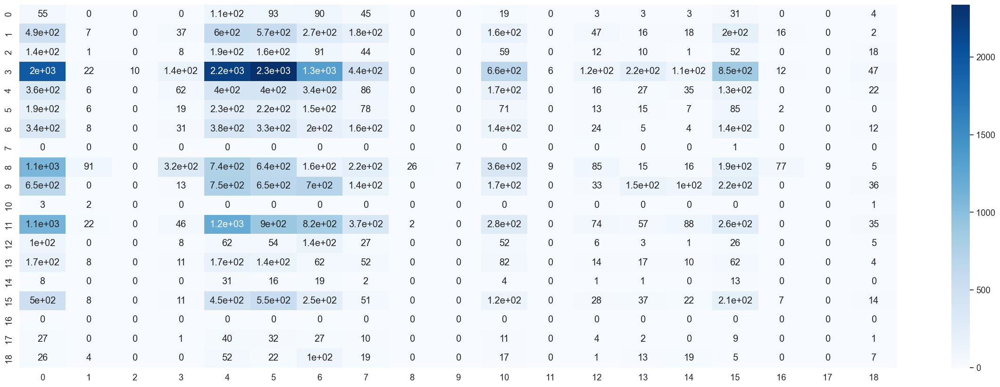

In [89]:
graph_confusion_matrix_train(predict_ac_lda, y_train_sampled)

HAC sobre LDA no separa bien los grupos ni identifica las categoríass.

In [90]:
# elimina variables
del predict_ac_lda, X_lda
# llama al recolector de basura para liberar memoria
gc.collect()

32329

# 3. t-SNE

In [91]:
n_components_tsne = 2   # 2
perplexity_tsne = 30.0   # 30.0: perplejidad, relacionada con la cantidad de vecinos más cercanos; Big Data, valores mayores; influye mucho en el resultado; aconsejado [5, 50]; < num_muestras
early_exaggeration_tsne= 12.0   # 12.0: densidad clústers y espacio entre ellos; parámetro no muy crítico; valor mayor, más espacio entre clústers
learning_rate_tsne = 'auto'   # auto: [10.0, 1:000.0]; demasiado grande, nube grande de poca densidad; demasiado pequeño, nube densa con pocos outliers; 'auto': máx(tamaño muestras / early_exaggeration / 4, 50)
max_iter_tsne = 1000   # 1000: >= 250
n_iter_without_progress_tsne = 300   # 300: usar múltiplos de 50; se usa tras 250 iteraciones iniciales con exageración temprana
min_grad_norm_tsne = 1e-07   # 1e-07: para si la norma del gradiente baja de este umbral
metric_tsne = 'euclidean'   # euclidean: string (sklearn.metrics.pairwise.distance_metrics())
init_tsne = 'pca'   # pca: pca/random/array (n_samples, n_components); pca suele ser más estable que random
angle_tsne = 0.5   # 0.5: sólo para 'barnes_hut'; equilibrio entre velocidad y precisión; >= 0.2; [0.2, 0.8]: poca variación a cambios dentro de este rango; mayor de 0.8: incrementa rápidamente el error

params_tsne = {'n_components': n_components_tsne, 'perplexity': perplexity_tsne, 'early_exaggeration': early_exaggeration_tsne, \
               'learning_rate': learning_rate_tsne, 'max_iter': max_iter_tsne, 'n_iter_without_progress': n_iter_without_progress_tsne, \
               'min_grad_norm': min_grad_norm_tsne, 'metric': metric_tsne, 'init': init_tsne, 'angle': angle_tsne}

In [92]:
tsne = TSNE(**params_tsne, verbose=1, random_state=42, n_jobs=-1)

print('Iterando...')

X_tsne = tsne.fit_transform(X_train)

print('Acabado')

Iterando...
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 362283 samples in 0.020s...
[t-SNE] Computed neighbors for 362283 samples in 215.326s...
[t-SNE] Computed conditional probabilities for sample 1000 / 362283
[t-SNE] Computed conditional probabilities for sample 2000 / 362283
[t-SNE] Computed conditional probabilities for sample 3000 / 362283
[t-SNE] Computed conditional probabilities for sample 4000 / 362283
[t-SNE] Computed conditional probabilities for sample 5000 / 362283
[t-SNE] Computed conditional probabilities for sample 6000 / 362283
[t-SNE] Computed conditional probabilities for sample 7000 / 362283
[t-SNE] Computed conditional probabilities for sample 8000 / 362283
[t-SNE] Computed conditional probabilities for sample 9000 / 362283
[t-SNE] Computed conditional probabilities for sample 10000 / 362283
[t-SNE] Computed conditional probabilities for sample 11000 / 362283
[t-SNE] Computed conditional probabilities for sample 12000 / 362283
[t-SNE] Computed condi

Preparo una versión de t-SNE muestreada.

In [93]:
print('Iterando...')

X_tsne_sampled = tsne.fit_transform(X_train_sampled)

print('Acabado')

Iterando...
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 36228 samples in 0.002s...
[t-SNE] Computed neighbors for 36228 samples in 2.447s...
[t-SNE] Computed conditional probabilities for sample 1000 / 36228
[t-SNE] Computed conditional probabilities for sample 2000 / 36228
[t-SNE] Computed conditional probabilities for sample 3000 / 36228
[t-SNE] Computed conditional probabilities for sample 4000 / 36228
[t-SNE] Computed conditional probabilities for sample 5000 / 36228
[t-SNE] Computed conditional probabilities for sample 6000 / 36228
[t-SNE] Computed conditional probabilities for sample 7000 / 36228
[t-SNE] Computed conditional probabilities for sample 8000 / 36228
[t-SNE] Computed conditional probabilities for sample 9000 / 36228
[t-SNE] Computed conditional probabilities for sample 10000 / 36228
[t-SNE] Computed conditional probabilities for sample 11000 / 36228
[t-SNE] Computed conditional probabilities for sample 12000 / 36228
[t-SNE] Computed conditional probabili

Graficamos

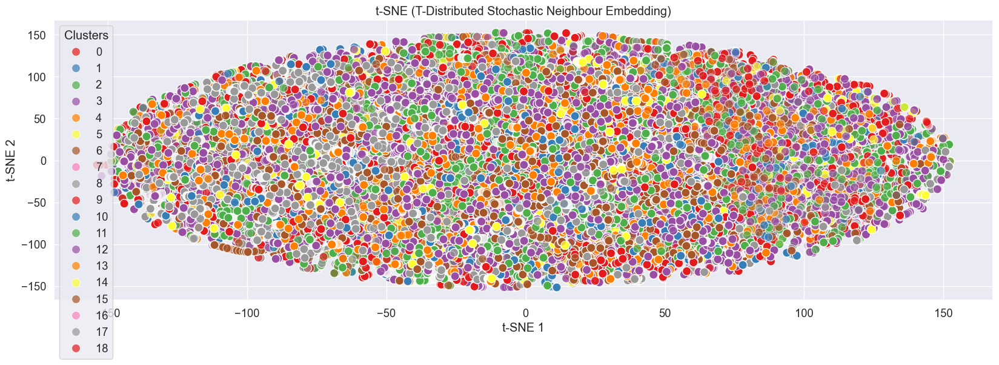

In [94]:
plt.figure(figsize=(20, 6))

sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=y_train['category_encoded'], palette='Set1', s=100, alpha=0.7)

plt.title("t-SNE (T-Distributed Stochastic Neighbour Embedding)")
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(title="Clusters", loc='best')
plt.grid(True)
plt.show()

t-SNE no muestra separación clara entre las clases, aún así vamos a aplicar los algoritmos de clusterización.

### 3-1. K-Means

Número de clusters: el análisis de siluetas del dataset ya se ha realizado en el apartado anterior de PCA, vamos a trabajar por tanto con 4 y 19 clusters.

- 4 clusters

In [95]:
n_clusters_kmeans = 4
kmeans_4 = KMeans(n_clusters=n_clusters_kmeans, verbose=2, random_state=10)

In [96]:
kmeans_tsne_4 = kmeans_4.fit(X_tsne)
predicted_kmeans_tsne_4 = kmeans_tsne_4.predict(X_tsne)

Initialization complete
Iteration 0, inertia 1413580032.0.
Iteration 1, inertia 1091671552.0.
Iteration 2, inertia 1016788416.0.
Iteration 3, inertia 1004855424.0.
Iteration 4, inertia 1002636160.0.
Iteration 5, inertia 1002119104.0.
Iteration 6, inertia 1001999232.0.
Converged at iteration 6: center shift 0.29934537410736084 within tolerance 0.45884541015625.


Graficamos

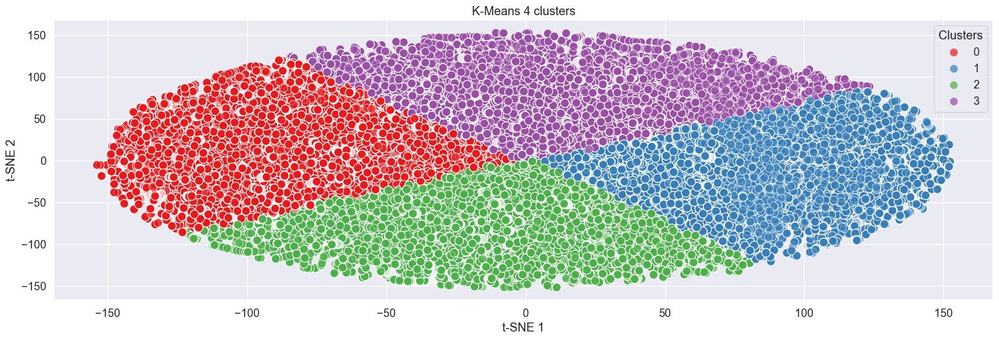

In [97]:
plt.figure(figsize=(20, 6))

sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=predicted_kmeans_tsne_4, palette='Set1', s=100, alpha=0.7)

plt.title("K-Means 4 clusters")
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(title="Clusters", loc='best')
plt.grid(True)
plt.show()

- 19 clusters

In [98]:
n_clusters_kmeans = 19
kmeans_19 = KMeans(n_clusters=n_clusters_kmeans, verbose=2, random_state=10)

In [99]:
kmeans_tsne_19 = kmeans_19.fit(X_tsne)
predicted_kmeans_tsne_19 = kmeans_tsne_19.predict(X_tsne)

Initialization complete
Iteration 0, inertia 259079104.0.
Iteration 1, inertia 228678016.0.
Iteration 2, inertia 224506384.0.
Iteration 3, inertia 222504512.0.
Iteration 4, inertia 221282944.0.
Iteration 5, inertia 220456976.0.
Iteration 6, inertia 219748752.0.
Iteration 7, inertia 219209104.0.
Iteration 8, inertia 218754464.0.
Iteration 9, inertia 218248544.0.
Iteration 10, inertia 217802256.0.
Iteration 11, inertia 217452256.0.
Iteration 12, inertia 217118560.0.
Iteration 13, inertia 216812576.0.
Iteration 14, inertia 216546448.0.
Iteration 15, inertia 216345440.0.
Iteration 16, inertia 216148880.0.
Iteration 17, inertia 215912096.0.
Iteration 18, inertia 215696080.0.
Iteration 19, inertia 215512576.0.
Iteration 20, inertia 215360912.0.
Iteration 21, inertia 215229568.0.
Iteration 22, inertia 215104000.0.
Iteration 23, inertia 215010592.0.
Iteration 24, inertia 214953968.0.
Iteration 25, inertia 214904448.0.
Iteration 26, inertia 214849184.0.
Iteration 27, inertia 214793984.0.
Iterat

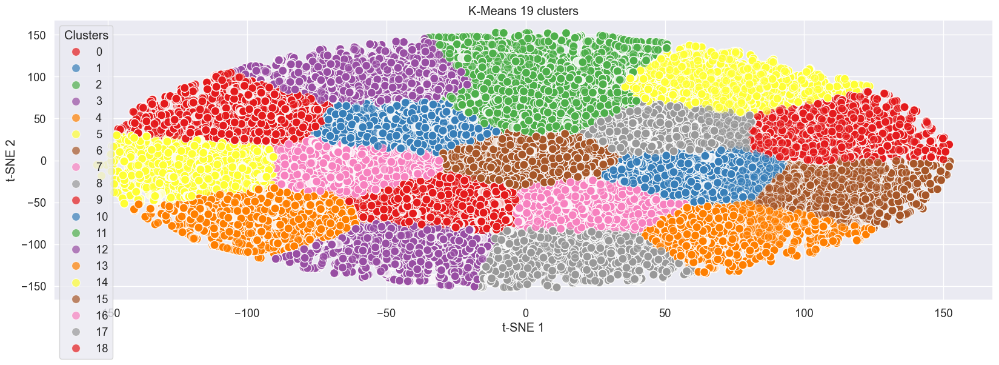

In [100]:
plt.figure(figsize=(20, 6))

sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=predicted_kmeans_tsne_19, palette='Set1', s=100, alpha=0.7)

plt.title("K-Means 19 clusters")
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(title="Clusters", loc='best')
plt.grid(True)
plt.show()

### Categorías de los vídeos

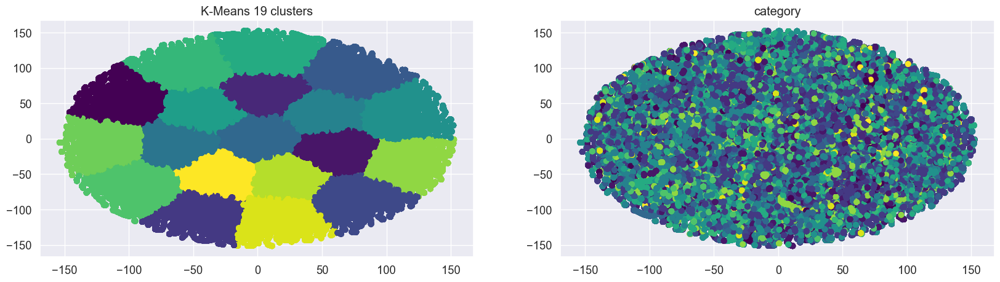

In [101]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# predicciones de K-Means con 19 clusters
plt.subplot(121)
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=predicted_kmeans_tsne_19, cmap='viridis')
plt.title('K-Means 19 clusters')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y_train['category_encoded'], cmap='viridis')
plt.title('category')

plt.show()

In [102]:
print_score_train(predicted_kmeans_tsne_19, y_train)

Result:
Accuracy Score: 6.08%
_______________________________________________
CLASSIFICATION REPORT:
                     0             1            2              3  \
precision     0.011251      0.086347     0.037356       0.239282   
recall        0.044105      0.069474     0.102941       0.037528   
f1-score      0.017928      0.076997     0.054819       0.064880   
support    4648.000000  25981.000000  7616.000000  104403.000000   

                      4             5             6     7             8  \
precision      0.054658      0.035495      0.073760   0.0      0.087021   
recall         0.049808      0.059777      0.099557   0.0      0.042720   
f1-score       0.052120      0.044542      0.084739   0.0      0.057307   
support    20097.000000  11041.000000  18522.000000  30.0  41245.000000   

                      9  ...           12           13          14  \
precision      0.184799  ...     0.006014     0.032483    0.001109   
recall         0.095786  ...     0.023968 

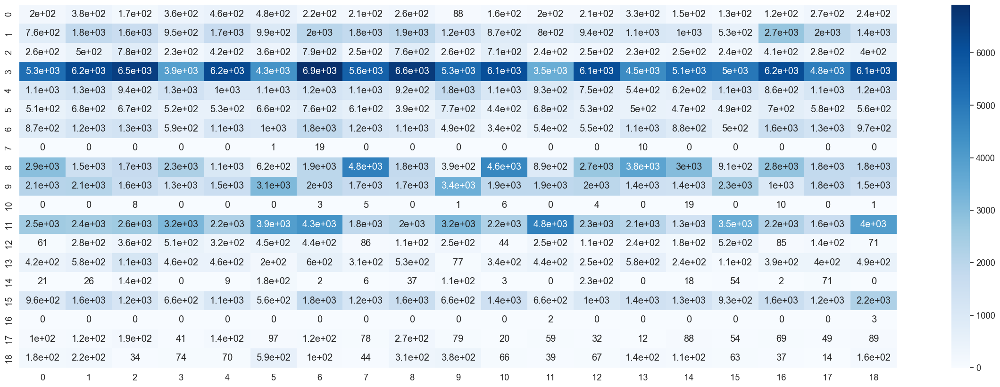

In [103]:
graph_confusion_matrix_train(predicted_kmeans_tsne_19, y_train)

Aunque K-Means separa muy bien los grupos en el dataset, no es capaz de identificar las categorías.

In [104]:
# elimina variables
del predicted_kmeans_tsne_4, predicted_kmeans_tsne_19
# llama al recolector de basura para liberar memoria
gc.collect()

46579

### 3-2. Mean Shift

In [105]:
# estimación del radio de ventana
n_samples = int(X_tsne.shape[0]*0.25)
print('n_samples:', n_samples)

bandwidth = estimate_bandwidth(X_tsne, quantile = 0.5, n_samples = n_samples)
print('bandwidth:', bandwidth)

n_samples: 90570
bandwidth: 122.3170493649136


Como en los casos anteriores, usamos el radio estimado para hacer pruebas con valores inferiores.

In [106]:
seeds_tsne = None   # None: semillas para inicializar el centroide; matriz (n_samples, n_features)
bin_seeding_tsne = True   # False: True: inicialización más rápida al agrupar los puntos en bins antes de calcular los clusters; bueno para grandes conjuntos de datos, especialmente con bandwidth pequeños; sin uso si seeds != None
bandwidth_tsne = 20   # None: radio de la ventana; None: estimado; float
min_bin_freq_tsne = 1   # 1: mín. puntos de cada centroide
cluster_all_tsne = False   # True: False, admite huérfanos (grupo -1)
max_iter_tsne = 300   # 300: máx. iteraciones por semilla

params_ms_tsne = {'bandwidth': bandwidth_tsne, 'bin_seeding': bin_seeding_tsne, 'cluster_all': cluster_all_tsne, 'min_bin_freq': min_bin_freq_tsne, 'max_iter': max_iter_tsne}

In [107]:
ms_tsne = MeanShift(**params_ms_tsne, n_jobs=-1)

print('Iterando...')

model_ms_tsne = ms_tsne.fit(X_tsne)
predicted_ms_tsne = model_ms_tsne.predict(X_tsne)

labels_ms_tsne = model_ms_tsne.labels_
centers_ms_tsne = model_ms_tsne.cluster_centers_

print('Número de clusters:', len(centers_ms_tsne))

Iterando...
Número de clusters: 16


Graficamos

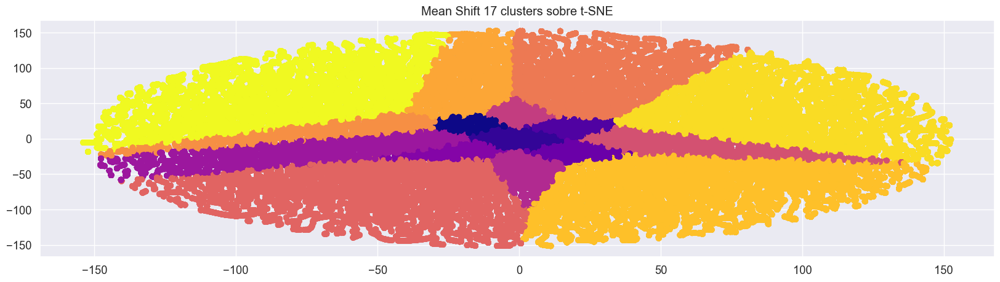

In [108]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=predicted_ms_tsne, cmap='plasma')
plt.title('Mean Shift 17 clusters sobre t-SNE')
plt.show()

### Categorías de los vídeos

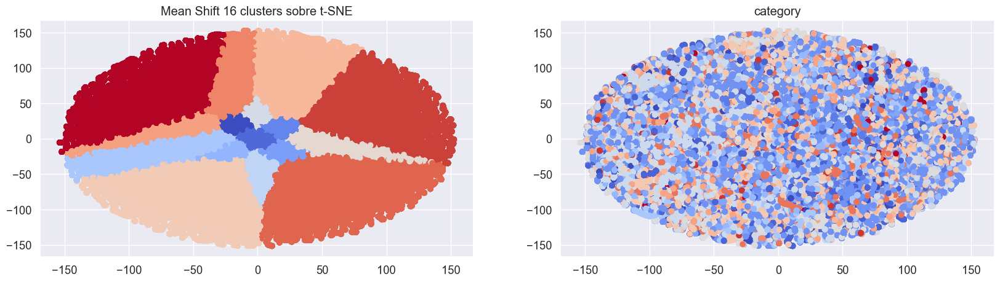

In [109]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# Mean Shift
plt.subplot(121)
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=predicted_ms_tsne, cmap='coolwarm')
plt.title('Mean Shift 16 clusters sobre t-SNE')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y_train['category_encoded'], cmap='coolwarm')
plt.title('category')

plt.show()

In [110]:
print_score_train(predicted_ms_tsne, y_train)

Result:
Accuracy Score: 4.28%
_______________________________________________
CLASSIFICATION REPORT:
                     0             1            2              3  \
precision     0.005669      0.073681     0.042338       0.375139   
recall        0.004948      0.016281     0.026917       0.019425   
f1-score      0.005284      0.026669     0.032911       0.036937   
support    4648.000000  25981.000000  7616.000000  104403.000000   

                      4             5             6     7             8  \
precision      0.032758      0.028549      0.097100   0.0      0.072938   
recall         0.008310      0.058962      0.047187   0.0      0.027373   
f1-score       0.013257      0.038471      0.063511   0.0      0.039807   
support    20097.000000  11041.000000  18522.000000  30.0  41245.000000   

                      9  ...           12           13          14  \
precision      0.075796  ...     0.008408     0.019363    0.005183   
recall         0.119474  ...     0.035064 

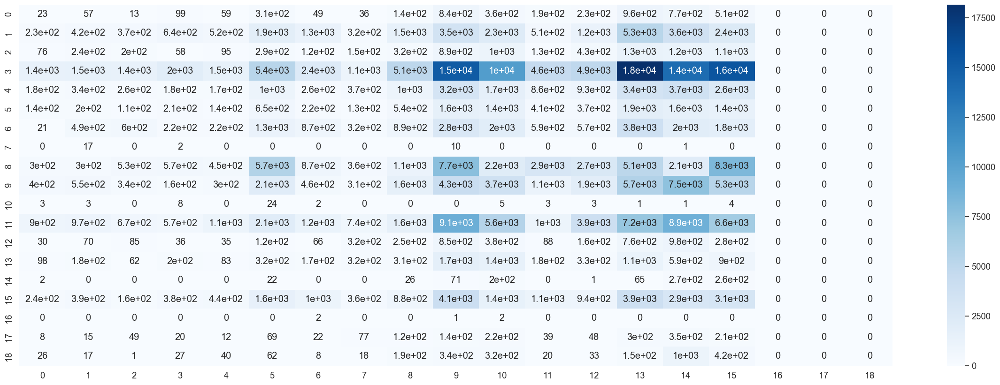

In [111]:
graph_confusion_matrix_train(predicted_ms_tsne, y_train)

De los gráficos no se aprecia que Mean Shift esté obteniendo grupos que tengan relación con las categorías.

In [112]:
# elimina variables
del predicted_ms_tsne
# llama al recolector de basura para liberar memoria
gc.collect()

38890

### 3-3. DBSCAN

In [113]:
eps_tsne = 4.0   # 0.5: epsilon, distancia de vecindad; > 0
min_samples_tsne = 10   # 5: mínimo de puntos dentro de una vecindad
metric_tsne = 'euclidean'   # euclidean; para alta dimensionalidad, mejor 'cosine' o 'manhattan'
algorithm_tsne = 'auto'   # auto: 'auto', 'ball_tree', 'kd_tree', 'brute' (calcula todas las distancias); big data, más rápido usar tipo árbol
leaf_size_tsne = 30   # 30: tamaño de hoja para ball_tree y kd_tree; mayor tamaño, menos hojas, entrenamiento más rápido y consultas más lentas 

params_dbscan_tsne = {'eps':eps_tsne, 'min_samples':min_samples_tsne, 'metric':metric_tsne, 'algorithm':algorithm_tsne, 'leaf_size':leaf_size_tsne}

In [114]:
print('Iterando...')

dbscan_tsne = DBSCAN(**params_dbscan_tsne, n_jobs=-1)

predicted_dbscan_tsne = dbscan_tsne.fit_predict(X_tsne)   # DBSCAN no tiene atributo 'predict'

print('Number of clusters:', len(set(predicted_dbscan_tsne)) - (1 if -1 in predicted_dbscan_tsne else 0))
print('Number of outliers:', list(predicted_dbscan_tsne).count(-1))

Iterando...
Number of clusters: 67
Number of outliers: 0


Graficamos

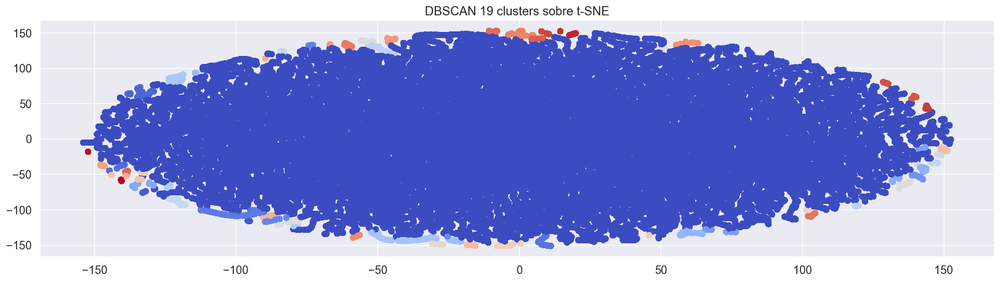

In [115]:
# Graficar resultados de DBSCAN
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# variable category_encoded
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=predicted_dbscan_tsne, cmap='coolwarm')
plt.title('DBSCAN 19 clusters sobre t-SNE')

plt.show()

DBSCAN sobre t-SNE presenta un gran cluster mayoritario y el resto muy pequeños.

### Categorías de los vídeos

In [116]:
eps_tsne = 5.1   # 0.5: epsilon, distancia de vecindad; > 0
min_samples_tsne = 10   # 5: mínimo de puntos dentro de una vecindad
metric_tsne = 'euclidean'   # euclidean; para alta dimensionalidad, mejor 'cosine' o 'manhattan'
algorithm_tsne = 'auto'   # auto: 'auto', 'ball_tree', 'kd_tree', 'brute' (calcula todas las distancias); big data, más rápido usar tipo árbol
leaf_size_tsne = 30   # 30: tamaño de hoja para ball_tree y kd_tree; mayor tamaño, menos hojas, entrenamiento más rápido y consultas más lentas 

params_dbscan_tsne_cat = {'eps':eps_tsne, 'min_samples':min_samples_tsne, 'metric':metric_tsne, 'algorithm':algorithm_tsne, 'leaf_size':leaf_size_tsne}

In [117]:
print('Iterando...')

dbscan_tsne_cat = DBSCAN(**params_dbscan_tsne_cat, n_jobs=-1)

predicted_dbscan_tsne_cat = dbscan_tsne_cat.fit_predict(X_tsne)   # DBSCAN no tiene atributo 'predict'

print('Number of clusters:', len(set(predicted_dbscan_tsne_cat)) - (1 if -1 in predicted_dbscan_tsne_cat else 0))
print('Number of outliers:', list(predicted_dbscan_tsne_cat).count(-1))

Iterando...
Number of clusters: 19
Number of outliers: 0


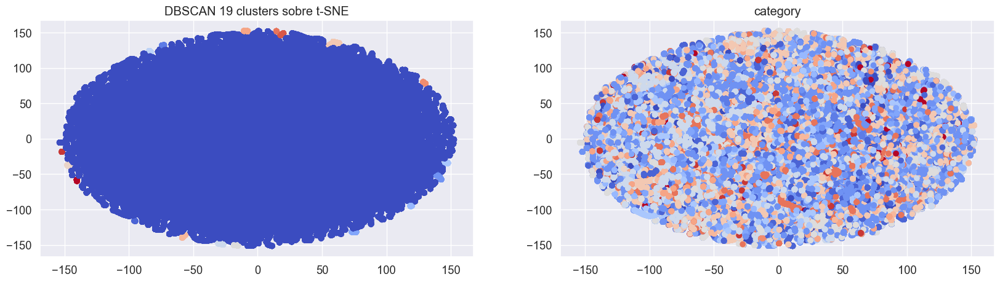

In [118]:
# Graficar resultados de DBSCAN
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# predicciones de DBSCAN
plt.subplot(121)
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=predicted_dbscan_tsne_cat, cmap='coolwarm')
plt.title('DBSCAN 19 clusters sobre t-SNE')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y_train['category_encoded'], cmap='coolwarm')
plt.title('category')

plt.show()

In [119]:
print_score_train(predicted_dbscan_tsne_cat, y_train)

Result:
Accuracy Score: 1.33%
_______________________________________________
CLASSIFICATION REPORT:
                     0        1       2              3        4        5  \
precision     0.012881      0.0     0.0       0.919255      0.0      0.0   
recall        0.999570      0.0     0.0       0.001418      0.0      0.0   
f1-score      0.025434      0.0     0.0       0.002831      0.0      0.0   
support    4648.000000  25981.0  7616.0  104403.000000  20097.0  11041.0   

                 6     7        8             9  ...      12      13     14  \
precision      0.0   0.0      0.0      0.159574  ...     0.0     0.0    0.0   
recall         0.0   0.0      0.0      0.000420  ...     0.0     0.0    0.0   
f1-score       0.0   0.0      0.0      0.000838  ...     0.0     0.0    0.0   
support    18522.0  30.0  41245.0  35715.000000  ...  4506.0  8032.0  909.0   

                15   16      17      18  accuracy      macro avg  \
precision      0.0  0.0     0.0     0.0  0.013274     

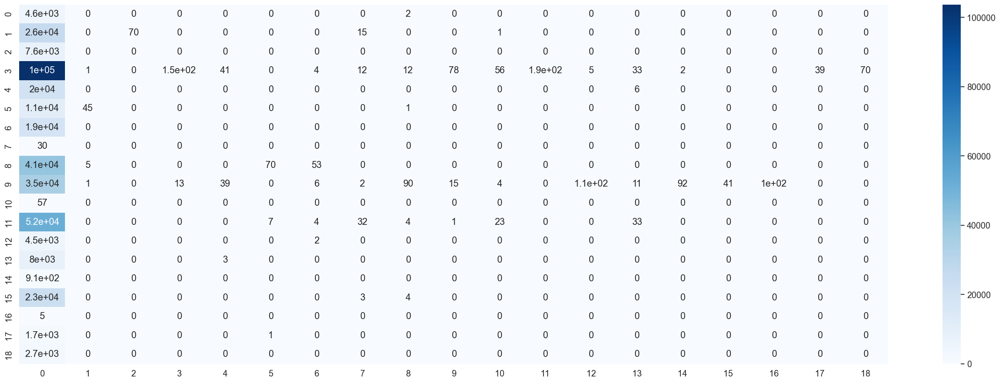

In [120]:
graph_confusion_matrix_train(predicted_dbscan_tsne_cat, y_train)

No hay identificación entre grupos y categorías con DBSCAN.

In [121]:
# elimina variables
del predicted_dbscan_tsne, predicted_dbscan_tsne_cat
# llama al recolector de basura para liberar memoria
gc.collect()

32519

### 3-4. HAC

In [122]:
n_clusters_tsne = 19   # 2: None si distance_threshold != None
metric_tsne = 'euclidean'   # euclidean: euclidean/li/l2/manhattan/cosine/precomputed; si linkage=ward, sólo euclidean
compute_full_tree_tsne = 'auto'   # auto: auto/True/False; el árbol se detiene al llegar a n_clusters; útil para menor tiempo de cálculo
distance_threshold_tsne = None   # None: float; umbral de distancia, los clústers sólo se fusionan por debajo de este umbral; float -> n_clusters debe ser None y compute_full_tree debe ser True
linkage_tsne = 'ward'   # ward: ward/complete/average/single; qué distancia usar entre conjuntos de observaciones

params_ac_tsne = {'n_clusters': n_clusters_tsne, 'metric': metric_tsne, 'compute_full_tree': compute_full_tree_tsne, 'distance_threshold': distance_threshold_tsne, 'linkage': linkage_tsne}

In [123]:
ac_tsne = AgglomerativeClustering(**params_ac_tsne)

print('Iterando...')

# por necesidades computacionales utilizo la versión muestreada
predict_ac_tsne = ac_tsne.fit_predict(X_tsne_sampled)

labels_ac_tsne = ac_tsne.labels_
clusters_ac_tsne = ac_tsne.n_clusters_

print('Número de clusters:', clusters_ac_tsne)

Iterando...
Número de clusters: 19


Graficamos

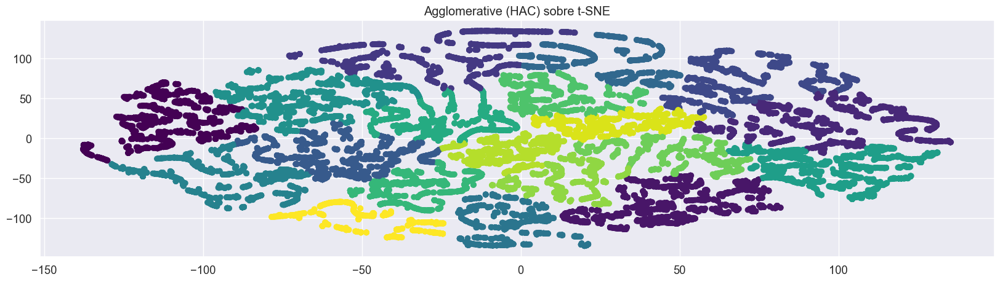

In [124]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

plt.scatter(X_tsne_sampled[:, 0], X_tsne_sampled[:, 1], c=predict_ac_tsne, cmap='viridis')
plt.title('Agglomerative (HAC) sobre t-SNE')
plt.show()

HAC sí muestra una separación clara entre las clases.

### Categorías de los vídeos

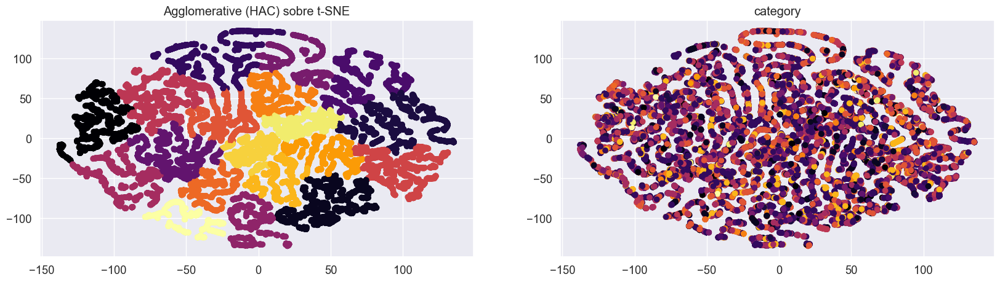

In [125]:
sns.set(font_scale=1.2)
plt.figure(figsize=(20, 5))

# predicciones de HAC
plt.subplot(121)
plt.scatter(X_tsne_sampled[:, 0], X_tsne_sampled[:, 1], c=predict_ac_tsne, cmap='inferno')
plt.title('Agglomerative (HAC) sobre t-SNE')

# variable category_encoded
plt.subplot(122)
plt.scatter(X_tsne_sampled[:, 0], X_tsne_sampled[:, 1], c=y_train_sampled['category_encoded'], cmap='inferno')
plt.title('category')

plt.show()

In [126]:
print_score_train(predict_ac_tsne, y_train_sampled)

Result:
Accuracy Score: 6.93%
_______________________________________________
CLASSIFICATION REPORT:
                    0            1           2             3            4  \
precision    0.010970     0.087677    0.026427      0.319016     0.060179   
recall       0.054825     0.083174    0.087786      0.068308     0.062378   
f1-score     0.018282     0.085366    0.040624      0.112523     0.061259   
support    456.000000  2609.000000  786.000000  10438.000000  2052.000000   

                     5            6    7            8            9  ...  \
precision     0.027677     0.044921  0.0     0.244398     0.089853  ...   
recall        0.063653     0.036558  0.0     0.115860     0.064177  ...   
f1-score      0.038580     0.040310  0.0     0.157198     0.074875  ...   
support    1084.000000  1778.000000  1.0  4048.000000  3615.000000  ...   

                   12          13         14           15   16          17  \
precision    0.004824    0.035119   0.001137     0.068166  

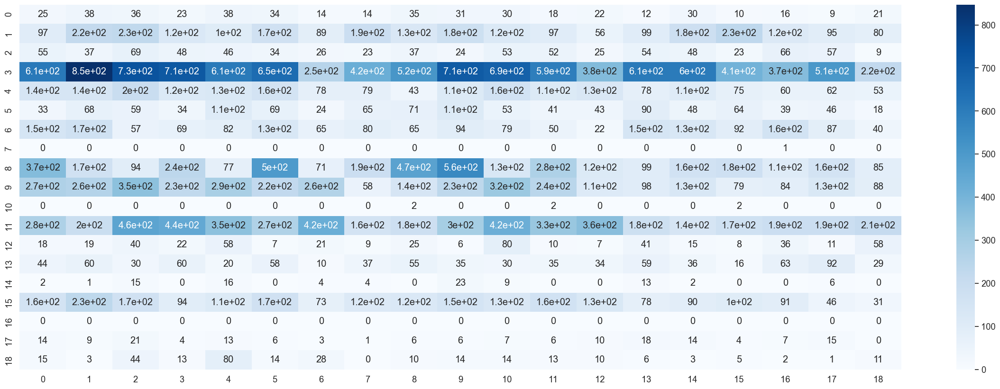

In [127]:
graph_confusion_matrix_train(predict_ac_tsne, y_train_sampled)

HAC tampoco presenta similitudes entre las categorías y los grupos.

In [128]:
# elimina variables
del predict_ac_tsne, X_tsne, X_tsne_sampled
# llama al recolector de basura para liberar memoria
gc.collect()

32258

# Conclusiones

Ninguno de los tres métodos de reducción de dimensionalidad aplicados conduce a una separación clara de grupos en el dataset, aunque LDA produce unos resultados ligeramente mejores que PCA y t-SNE, pero con una baja accuracy de sólo el 30%.<br>
En cuanto a las técnicas de clusterización aplicadas tras la reducción de dimensionalidad, los resultados siguen siendo malos.<br>
Vamos a industrializar K-Means sobre LDA dado que ofrece resultados ligeramente mejores que los demás métodos estudiados.